# TalentSprint

## Objectives

At the end of the experiment, you will be able to

* understand Word2vec
* apply word2vec on any dataset to extract meaningful featuresfrom the dataset

## Dataset

The dataset choosen for this experiment is IMDB movie reviews dataset. The dataset contains 791 samples and 3 columns.

**Importing necessary libraries**

In [96]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import string
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from gensim.models import Word2Vec
import nltk
nltk.download('punkt')

[nltk_data] Error loading punkt: <urlopen error [Errno -2] Name or
[nltk_data]     service not known>


False

In [97]:
data = pd.read_csv("IMDBMovieReviews.csv")

In [98]:
data.shape

(790, 2)

In [99]:
data.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [101]:
data = data.dropna()

In [102]:
reviews = data["review"]
labels = data["sentiment"]

**Pre-processing the reviews**

In [103]:
#start replaceTwoOrMore
def replaceTwoOrMore(s):
    #look for 2 or more repetitions of character and replace with the character itself
    pattern = re.compile(r"(.)\1{1,}", re.DOTALL)
    return pattern.sub(r"\1\1", s)

In [104]:
#start process_review
def processReview(review):
    # Removing numbers
    review = re.sub('[0-9]', '', review) 
    #Convert to lower case
    review = review.lower()
    review = review.translate(str.maketrans('', '', string.punctuation))   
    #Remove additional white spaces
    review = re.sub('[\s]+', ' ', review)
    #Replace #word with word
    review = re.sub(r'#([^\s]+)', r'\1', review)
    #trim
    review = review.strip('\'"')
    review = review.strip('.,')
    review = replaceTwoOrMore(review)
    return review

In [105]:
processedReviews = []
for review in reviews:
    processedReviews.append(processReview(review).split())

processedReviews

[['one',
  'of',
  'the',
  'other',
  'reviewers',
  'has',
  'mentioned',
  'that',
  'after',
  'watching',
  'just',
  'oz',
  'episode',
  'youll',
  'be',
  'hooked',
  'they',
  'are',
  'right',
  'as',
  'this',
  'is',
  'exactly',
  'what',
  'happened',
  'with',
  'mebr',
  'br',
  'the',
  'first',
  'thing',
  'that',
  'struck',
  'me',
  'about',
  'oz',
  'was',
  'its',
  'brutality',
  'and',
  'unflinching',
  'scenes',
  'of',
  'violence',
  'which',
  'set',
  'in',
  'right',
  'from',
  'the',
  'word',
  'go',
  'trust',
  'me',
  'this',
  'is',
  'not',
  'a',
  'show',
  'for',
  'the',
  'faint',
  'hearted',
  'or',
  'timid',
  'this',
  'show',
  'pulls',
  'no',
  'punches',
  'with',
  'regards',
  'to',
  'drugs',
  'sex',
  'or',
  'violence',
  'its',
  'is',
  'hardcore',
  'in',
  'the',
  'classic',
  'use',
  'of',
  'the',
  'wordbr',
  'br',
  'it',
  'is',
  'called',
  'oz',
  'as',
  'that',
  'is',
  'the',
  'nickname',
  'given',
  'to

## Extracting Features from reviews

In [106]:
model = Word2Vec(sentences = processedReviews, size = 100, sg = 1, window = 3, min_count = 1, iter = 10)

In [85]:
w2c = dict()
for item in model.wv.vocab:
    w2c[item] = model.wv.vocab[item].count

In [86]:
w2c

{'one': 757,
 'of': 4770,
 'the': 10814,
 'other': 295,
 'reviewers': 6,
 'has': 498,
 'mentioned': 23,
 'that': 2066,
 'after': 219,
 'watching': 145,
 'just': 597,
 'oz': 7,
 'episode': 45,
 'youll': 39,
 'be': 792,
 'hooked': 7,
 'they': 622,
 'are': 966,
 'right': 84,
 'as': 1457,
 'this': 2443,
 'is': 3204,
 'exactly': 29,
 'what': 490,
 'happened': 19,
 'with': 1421,
 'mebr': 6,
 'br': 1833,
 'first': 262,
 'thing': 127,
 'struck': 10,
 'me': 359,
 'about': 572,
 'was': 1530,
 'its': 765,
 'brutality': 2,
 'and': 5172,
 'unflinching': 2,
 'scenes': 184,
 'violence': 50,
 'which': 432,
 'set': 76,
 'in': 2983,
 'from': 654,
 'word': 48,
 'go': 170,
 'trust': 8,
 'not': 971,
 'a': 5077,
 'show': 142,
 'for': 1400,
 'faint': 2,
 'hearted': 3,
 'or': 548,
 'timid': 1,
 'pulls': 7,
 'no': 418,
 'punches': 3,
 'regards': 3,
 'to': 4252,
 'drugs': 32,
 'sex': 51,
 'hardcore': 4,
 'classic': 55,
 'use': 74,
 'wordbr': 2,
 'it': 2285,
 'called': 38,
 'nickname': 2,
 'given': 68,
 'oswald'

In [108]:
words = list(model.wv.vocab)
print(words)

['one', 'of', 'the', 'other', 'reviewers', 'has', 'mentioned', 'that', 'after', 'watching', 'just', 'oz', 'episode', 'youll', 'be', 'hooked', 'they', 'are', 'right', 'as', 'this', 'is', 'exactly', 'what', 'happened', 'with', 'mebr', 'br', 'first', 'thing', 'struck', 'me', 'about', 'was', 'its', 'brutality', 'and', 'unflinching', 'scenes', 'violence', 'which', 'set', 'in', 'from', 'word', 'go', 'trust', 'not', 'a', 'show', 'for', 'faint', 'hearted', 'or', 'timid', 'pulls', 'no', 'punches', 'regards', 'to', 'drugs', 'sex', 'hardcore', 'classic', 'use', 'wordbr', 'it', 'called', 'nickname', 'given', 'oswald', 'maximum', 'security', 'state', 'penitentary', 'focuses', 'mainly', 'on', 'emerald', 'city', 'an', 'experimental', 'section', 'prison', 'where', 'all', 'cells', 'have', 'glass', 'fronts', 'face', 'inwards', 'so', 'privacy', 'high', 'agenda', 'em', 'home', 'manyaryans', 'muslims', 'gangstas', 'latinos', 'christians', 'italians', 'irish', 'moreso', 'scuffles', 'death', 'stares', 'dodgy

In [111]:
for word in words:
    print(model[word])

/home/chandrakumar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


[-0.17852978 -0.04652205  0.42810652 -0.3612047  -0.01656599  0.13104896
  0.17649537 -0.06671559  0.34239525 -0.16001056  0.12964016 -0.14240104
 -0.5726062   0.33947122  0.64777225  0.11657313 -0.22553997  0.29612875
  0.23748358  0.11654218 -0.3203029   0.44883776  0.25491664  0.3020374
  0.25216848 -0.43782538 -0.01473352  0.11967281 -0.4230977   0.00595268
  0.41282624  0.18014957  0.04950614 -0.3126091  -0.10540057  0.30970466
 -0.15165485  0.01522166 -0.10842667 -0.22840717  0.16303092  0.49847594
 -0.17774414 -0.09216331  0.10301741  0.5850251   0.3341542  -0.06124145
  0.48457685 -0.07926878  0.17620346 -0.01532287  0.17586276  0.4508773
 -0.08702628  0.22707786  0.00158458  0.16447905  0.19376719  0.23536529
 -0.3643312  -0.02344551  0.20876938  0.01322223 -0.2859222  -0.08833905
  0.6069599   0.21159485 -0.45609158  0.2939005   0.10983892  0.49002737
 -0.20575558  0.35417038 -0.60845184  0.6971003   0.21955347  0.1357031
 -0.2698405   0.0077627  -0.2954396  -0.06880922  0.09

  3.47113721e-02 -1.67502820e-01  1.20034799e-01  2.61695385e-01]
[ 0.1000019  -0.0336192   0.11696769 -0.03955536 -0.01452251  0.02586705
 -0.00889036 -0.04015553 -0.02344805 -0.01158794 -0.03910113 -0.02810621
  0.01210413  0.05603056  0.07763495  0.05417744  0.01461143  0.0617992
 -0.03184234 -0.00078242 -0.03088106  0.04753054  0.14911582  0.04196
  0.02505694  0.03140986  0.05414089 -0.07054073 -0.0449652  -0.02687722
  0.05715989  0.14441809  0.00422067 -0.1152402  -0.01862095 -0.00425656
 -0.01582481 -0.07191994  0.07257529  0.05952293  0.02528411  0.00422479
 -0.01413796  0.10122333 -0.03108441  0.02700546 -0.02300476  0.05411238
  0.1497316   0.08348237  0.11128593 -0.01745148  0.03065231 -0.01095974
  0.01553501 -0.02092962  0.04245725  0.15364482  0.08325057  0.07360335
 -0.00148164  0.00526127 -0.01211287  0.06373535 -0.0597368  -0.01675214
  0.10208333  0.02583382  0.0643129   0.03236355 -0.03061074  0.12569101
  0.0175476   0.02308234 -0.16873142  0.05298981 -0.07576972 -

  0.02418839 -0.06211022 -0.00168728  0.08900696]
[ 0.12661892 -0.05905944  0.29748654 -0.04579124 -0.10804855  0.1681286
  0.00199682 -0.06979935 -0.05959222 -0.13476412 -0.14348327 -0.05732269
 -0.07826265  0.35388044  0.21989289  0.14904016  0.03980405  0.19871491
  0.12320822  0.09146139 -0.09345857  0.16369385  0.21807453  0.01309193
  0.05779725 -0.17138647  0.00899051  0.03873146 -0.10048965  0.0344958
  0.20939405  0.26106533 -0.10262465 -0.13705817 -0.07079256  0.13144864
 -0.06480701 -0.21234913  0.01998889 -0.07544935  0.06622203  0.12558411
 -0.08056304  0.217406   -0.05661512  0.07852542  0.16436842 -0.08155093
  0.16795282  0.1695897   0.16713482 -0.0879441   0.19960664  0.08872846
  0.09108341  0.06063586  0.15332936  0.42451468  0.1617354   0.1934467
 -0.07664871  0.02682775  0.1474989   0.08456951 -0.12492073 -0.11344491
  0.40168348 -0.04028453 -0.06086365  0.21683976 -0.06220833  0.18751876
 -0.00417029  0.22168896 -0.39484718  0.29556155 -0.12695144  0.01964444
  0.

  0.07041083 -0.26082     0.05825594  0.24652444]
[ 0.07701897 -0.02499696  0.27765352  0.11519016 -0.22312143  0.10942385
  0.0942544  -0.01404513  0.05435947 -0.1431749  -0.21747519 -0.05790232
 -0.04899192  0.39313895  0.18168795  0.07861697 -0.04361111  0.24268056
  0.13769548  0.07726652 -0.08914036  0.1534369   0.14265431 -0.01458366
  0.0844522  -0.18362658 -0.03663343  0.14151473 -0.03946608  0.07423691
  0.26829812  0.35528037 -0.06833658 -0.17061326 -0.16207367  0.12128352
 -0.05874035 -0.08051167  0.08782296 -0.22055498  0.00499711  0.23212874
 -0.10243798  0.36075297 -0.09531672  0.05496515  0.1176189  -0.0825553
  0.11895876 -0.04443077  0.17282514 -0.18666933  0.16180173  0.00730683
  0.15784098  0.11105713  0.324482    0.55210376  0.25878975  0.26881498
  0.01824951  0.01528572  0.12827861  0.23815736 -0.14168312 -0.17891824
  0.4206648  -0.1439655  -0.03246113  0.28297022 -0.00412201  0.2692596
 -0.1344823   0.23846479 -0.53423893  0.348399   -0.10617288  0.08890647
  0

  0.16243221 -0.23709568  0.34625277  0.2461045 ]
[ 2.04325557e-01  1.83895975e-02  3.45179081e-01 -5.93719706e-02
 -5.56486882e-02  5.20394802e-01  7.73401186e-02  9.08470452e-02
 -1.09613486e-01 -2.34210283e-01 -2.65705228e-01  4.04772051e-02
 -1.85553774e-01  1.73697263e-01  2.53253043e-01  1.68151870e-01
 -1.47251971e-02  2.80501515e-01 -3.49502750e-02  1.52765319e-01
 -2.13017166e-02  2.36143067e-01  6.82435930e-02 -7.61393532e-02
 -1.22630104e-01 -1.68999389e-01  9.10181087e-03  1.10375576e-01
 -3.38156909e-01 -1.62532832e-02  4.50609863e-01  4.89162505e-01
 -1.81476697e-01 -4.06433225e-01 -3.68128389e-01  2.16121465e-01
  8.91678557e-02  5.51254787e-02 -1.29706919e-01 -1.83509335e-01
  2.95735208e-05  5.49823344e-02 -2.08727330e-01  3.76032293e-01
 -2.73884833e-01  1.68317810e-01 -6.99087158e-02 -8.32255781e-02
  1.43074647e-01  1.14146292e-01  9.61877406e-02 -5.88916093e-02
  3.90907258e-01  6.02876619e-02  6.72636181e-02  2.86449611e-01
  4.29394916e-02  3.16820472e-01  1.6993

  0.17301996 -0.48524395  0.05127864  0.35662293]
[ 0.03317986 -0.01831302  0.42750257  0.01905971 -0.17810433  0.285739
  0.13342929  0.00888602 -0.07806046  0.04653432 -0.21751224  0.05627862
 -0.11364548  0.40980774  0.32483873  0.12142741  0.07515068  0.3133795
 -0.02483451  0.17076658  0.00483346  0.15779068  0.07270883 -0.04683513
  0.0188643  -0.2468441  -0.00431685  0.21105911 -0.13974106  0.01635744
  0.22469416  0.43839332 -0.12956518 -0.16505764 -0.10357806  0.15215781
 -0.06651973  0.05983516 -0.18501055 -0.112172    0.07520343  0.1181718
 -0.15379949  0.24377678 -0.11844176  0.02892816  0.20778863  0.01911745
  0.18559961  0.17489892  0.35838366 -0.12660366  0.2982176   0.04418309
  0.00599947  0.1854647   0.22143973  0.65240556  0.188914    0.27110076
 -0.11581176 -0.03316758  0.19910155  0.09706656 -0.21463594 -0.28104368
  0.5278146  -0.14752355  0.01501484  0.25946382 -0.06924639  0.2340542
 -0.06318097  0.20619448 -0.52116835  0.38480863  0.00197581  0.05643809
 -0.09

  0.05730597 -0.11254484  0.00540002  0.08541937]
[ 0.11990631 -0.05749273  0.35756928  0.04770342 -0.13911723  0.34788418
  0.09263435 -0.05362217  0.04632889  0.12713571 -0.18951102 -0.09559014
  0.01447973  0.51407284  0.38052353  0.09839603  0.12109913  0.33170843
  0.11049874  0.16849737 -0.01373475  0.24929588  0.09341287 -0.04121816
  0.0299543  -0.29196692 -0.02113558  0.22138296 -0.1850515   0.03595196
  0.30867627  0.16559996 -0.10132587 -0.18312855 -0.13964614  0.13091226
 -0.03015838 -0.19910038 -0.15689303 -0.18829013  0.04038849  0.24099176
 -0.10537412  0.26074666  0.07632122  0.12057628  0.40242153  0.04971248
  0.11752882  0.24873938  0.1797147  -0.0819096   0.22457285  0.04767561
  0.0245123   0.27218002  0.21238677  0.62030345  0.0624854   0.20142768
 -0.03960941  0.02413534  0.2793345   0.11950925 -0.14600025 -0.27248117
  0.6054834  -0.12266462 -0.20508745  0.35842258  0.04108017  0.22166908
 -0.11014968  0.25175315 -0.5215448   0.45849967 -0.07355075  0.00273667
 

  8.17679316e-02 -3.31773221e-01  1.50565177e-01  3.28032225e-01]
[ 0.06606092  0.05733072  0.36760026 -0.14564455 -0.08605178  0.30358148
  0.05055596 -0.02426801 -0.10071719 -0.18268597 -0.1689497   0.04328703
 -0.13625012  0.44809118  0.3118589   0.20795333  0.06250186  0.29235545
  0.09783449  0.10034066 -0.08832485  0.2664457   0.17245075  0.01298028
  0.01748893 -0.27705997  0.00966167  0.17083088 -0.29293868  0.04274116
  0.2637584   0.34366006 -0.14934248 -0.24426898 -0.10564304  0.3709313
  0.04095396 -0.08884688 -0.08951685 -0.20687678  0.08197219  0.234158
 -0.17923653  0.17107356 -0.12969747  0.02662014  0.2683476  -0.04900344
  0.21242033  0.07545     0.16761121 -0.10933083  0.24759796  0.05754965
  0.06643671  0.12865974  0.20700765  0.44660553  0.11056474  0.24810411
 -0.16219406 -0.10211073  0.21014188  0.03437714 -0.1774687  -0.06118947
  0.60574615 -0.05027815 -0.07975246  0.18770602 -0.09747581  0.21349418
 -0.07562046  0.2457725  -0.3877839   0.43595067 -0.01158854 

  0.08330126 -0.33594644  0.08628906  0.4504964 ]
[ 5.00715934e-02  4.45410758e-01  2.60566175e-01  3.72708887e-02
 -3.93703490e-01  6.88538432e-01  3.56469363e-01  4.98983487e-02
  1.44919485e-01 -1.42883599e-01 -5.71043603e-02  1.20598674e-01
  1.57533705e-01  3.09922695e-01  4.89813089e-01  1.52684972e-01
  8.50505754e-02 -2.04327449e-01  9.68886614e-02  8.15722585e-01
 -1.24886341e-01  4.62604821e-01  2.47932691e-02  4.95106913e-02
  1.62161797e-01 -6.70627505e-02 -1.48956493e-01  3.43314141e-01
 -1.96011677e-01 -3.42171229e-02  4.76268202e-01  6.38889313e-01
  2.22303927e-01  8.23020935e-02 -6.28345788e-01  1.35641200e-02
 -2.86800772e-01  1.05552552e-02 -3.98661941e-01 -2.95918375e-01
 -2.02823460e-01 -1.12677649e-01  3.05581719e-01  3.67020786e-01
  1.93723783e-01  3.01130384e-01 -1.01452217e-01  4.96792886e-03
 -1.77467969e-04  1.99526679e-02  7.30154097e-01 -4.20910150e-01
  2.69657880e-01 -7.01647028e-02  5.35433963e-02  6.93476915e-01
  9.70934853e-02  1.04109335e+00  2.2336

 -0.00916681 -0.27764353  0.13953988  0.28476703]
[ 0.11110333 -0.02844119  0.16600761 -0.02522502 -0.02496276  0.04483091
 -0.00033227 -0.04211493 -0.02199759 -0.04657328 -0.08157686 -0.0515533
  0.03277555  0.13196516  0.13292493  0.05332727  0.0097037   0.0989344
  0.00816434  0.02073647 -0.03772527  0.07023916  0.1687144   0.00923719
  0.03469315 -0.02424217  0.05585141 -0.04094964 -0.0752912  -0.00470177
  0.09263214  0.1841116  -0.02647143 -0.12443836 -0.04692375  0.00671736
 -0.01627207 -0.10804634  0.07163084  0.01225635  0.02187767  0.04088486
 -0.02639657  0.14723346 -0.04920573  0.04549278  0.02199876  0.03810315
  0.16737312  0.085462    0.12936768 -0.04513443  0.0642948   0.01185938
  0.05692258  0.01883173  0.08920447  0.26165968  0.1216047   0.09118786
 -0.01617258  0.00061231  0.03705189  0.07958798 -0.07861132 -0.06344068
  0.2093283   0.00452472  0.02306177  0.08209053 -0.04603781  0.16439573
 -0.01147011  0.08584072 -0.24964218  0.13367292 -0.09795789 -0.02798745
  0

  0.06137558 -0.25029042  0.10333125  0.34145626]
[ 0.06248625 -0.03367984  0.10801103 -0.02273435 -0.02908095  0.02343875
  0.00767272 -0.02509614 -0.01236054 -0.02064165 -0.03134119 -0.01868464
  0.01027533  0.08818674  0.07611407  0.04109259  0.01221412  0.07700251
  0.00704083  0.01723253 -0.03116482  0.04300839  0.11385126  0.02190195
  0.02041064 -0.01186387  0.02429796 -0.03765058 -0.04151992 -0.00770551
  0.06286915  0.1089216  -0.01869502 -0.08182605 -0.01835321  0.00953647
 -0.02389751 -0.07217482  0.05238357  0.00808923  0.01876769  0.02565535
 -0.01088162  0.09063436 -0.03163834  0.03271154  0.01938936  0.02618464
  0.10824262  0.06348033  0.08985948 -0.0375495   0.03806917  0.0099184
  0.03322247  0.00223601  0.05643181  0.16996898  0.07950521  0.06244094
 -0.00167725  0.01104015  0.0180077   0.05070914 -0.05287021 -0.0431325
  0.12880762  0.01508482  0.02564998  0.06453001 -0.01916296  0.08923043
  0.00773682  0.03427541 -0.17282121  0.07952085 -0.06658214 -0.01685441
  0

  0.08875696 -0.18703425  0.0626505   0.2477541 ]
[ 0.17078818 -0.00987136  0.31115216 -0.09179267 -0.17736197  0.16234846
 -0.01502092 -0.12815419 -0.01448981  0.00148152 -0.05247353 -0.09371427
 -0.1482492   0.3596321   0.22101174  0.16993828  0.05122694  0.23589931
  0.00979793  0.00553976 -0.10742069  0.16197033  0.20136227  0.05587295
  0.05125972 -0.04300848  0.04044405  0.1448574  -0.16263434 -0.00446843
  0.17835003  0.2975758  -0.01024371 -0.27199307 -0.10237037  0.12858361
 -0.01831151 -0.19278443  0.00942304 -0.00202433  0.02233181  0.12832712
 -0.08043649  0.24749477 -0.09078337  0.08414525  0.0593912   0.014858
  0.20126693  0.19930042  0.13734387 -0.00099327  0.17283247  0.02139726
  0.02191127  0.04058766  0.13972956  0.38683528  0.10392795  0.3597129
  0.02748185 -0.0146095   0.05548512  0.0687012  -0.16086021 -0.08492502
  0.30323422  0.02641815  0.00319994  0.23278607 -0.08483683  0.23161796
  0.05099809  0.2020308  -0.46014845  0.2838704  -0.16598666  0.01292627
  0.

  0.22254357 -0.2844227   0.20041126  0.39080477]
[ 0.06611098 -0.15172763  0.31216758 -0.01291398 -0.11073981  0.0737768
 -0.09296172 -0.20094106 -0.04042056  0.03954419 -0.15834484 -0.16288744
  0.03631999  0.39839068  0.23810762  0.04377856  0.05703152  0.21547006
  0.14213932  0.07126475 -0.07382925  0.2821172   0.22213747 -0.04206261
  0.00670163 -0.10091622  0.10913068  0.1306583  -0.0372878   0.16395509
  0.23002487  0.25662357 -0.14480755 -0.20488015 -0.02631727  0.08093368
  0.03746559 -0.18975067 -0.05404039 -0.06683776  0.01498399  0.20482735
  0.03456171  0.23283    -0.10651363  0.19384024  0.17682709  0.03973526
  0.1237103   0.1952639   0.22354445 -0.18649743  0.16067745 -0.07730611
  0.09432717  0.14588475  0.16282652  0.41308358  0.06759902  0.11881181
 -0.08458772  0.01474143  0.14768746  0.13041654 -0.15529105 -0.09855288
  0.4484336  -0.01671379 -0.01123125  0.312426    0.11590931  0.23861268
 -0.02783247  0.26194474 -0.39896113  0.44215646 -0.08642825  0.13302061
 -

  0.03231469 -0.17182873  0.02628251  0.20999216]
[ 0.08487712 -0.02220693  0.10572726 -0.01664137 -0.04360699  0.02216414
  0.00037701 -0.0343533  -0.02051434 -0.00252839 -0.03760576 -0.00842319
 -0.0004672   0.08721854  0.07700357  0.05698757  0.02170324  0.0629299
 -0.02630823 -0.01526557 -0.03536461  0.039143    0.12723535  0.04614444
  0.0418246   0.01787461  0.05825883 -0.03937713 -0.04128605 -0.00905531
  0.05237886  0.14366096  0.00565431 -0.10862485 -0.00633997 -0.00165752
 -0.0237982  -0.06453297  0.05938589  0.0598238   0.03103285  0.0229059
 -0.0379389   0.10918301 -0.03001742 -0.00258779 -0.00820677  0.03226904
  0.12714401  0.07012699  0.11045571 -0.00990235  0.03571778 -0.00652366
  0.01308649 -0.03805352  0.05853117  0.17385331  0.09163725  0.10144122
  0.01456308  0.00816252 -0.00447852  0.05291752 -0.06160816 -0.02587066
  0.10467333  0.01192679  0.04847748  0.03826899 -0.03657746  0.13216718
  0.01959365  0.03091646 -0.18379235  0.05733643 -0.06990453 -0.02221658
  0

  6.04148470e-02 -1.06460147e-01 -1.64403766e-03  1.19676448e-01]
[ 0.14580803  0.03322638  0.28700304 -0.13322248 -0.16875012  0.08679154
  0.01615465 -0.10319836 -0.04658657  0.03964063 -0.03047594 -0.08780929
 -0.10102559  0.3248373   0.2452981   0.17214876  0.06342415  0.21797921
  0.01218489 -0.03016881 -0.1223336   0.12545586  0.2600577   0.03782624
  0.0680154  -0.0300994   0.05198046  0.05522278 -0.14210917 -0.027538
  0.09166905  0.24716565 -0.01961908 -0.22426468 -0.00312274  0.10494704
 -0.03362364 -0.2656138   0.09562577  0.05998378  0.0451769   0.11096748
 -0.07749964  0.20596513 -0.02878305  0.03654655  0.12158789  0.00067419
  0.23104754  0.22247787  0.19076188 -0.01619664  0.09076802  0.04465899
  0.04517493 -0.08438585  0.14294298  0.4569789   0.14672011  0.29252633
  0.04497249 -0.03743129  0.00102544  0.01353865 -0.13619134 -0.06349551
  0.25262108  0.09730376 -0.03173529  0.1867988  -0.11512868  0.23096873
  0.10742198  0.18285032 -0.4385303   0.25854987 -0.20701501

  0.05636656 -0.19958875  0.06400364  0.15349028]
[ 0.06977341 -0.03637396  0.21706796  0.03778737 -0.18018638  0.30220523
  0.05926562 -0.00183637  0.00729049 -0.17409162 -0.26453182 -0.06651597
  0.03108384  0.34018546  0.17528363  0.08356486 -0.01845486  0.27028298
  0.10704207  0.10961045 -0.06358671  0.33633876  0.22816214 -0.03621979
 -0.03422379 -0.26986918 -0.06730551  0.13304812 -0.26454803  0.04092822
  0.34351802  0.29992378 -0.11447549 -0.1313788  -0.1910474   0.22424477
 -0.00391676 -0.22006942 -0.04131553 -0.23332722 -0.05664894  0.1530634
 -0.08620439  0.44008595 -0.08698703  0.09277727  0.18818012 -0.11645637
  0.14999779  0.02818915  0.10132693 -0.26994368  0.22607522  0.03974104
  0.16096526  0.1949888   0.18411374  0.57739884  0.22863209  0.2104644
 -0.00970874  0.1106016   0.13242945  0.1835467  -0.22575518 -0.23689365
  0.6504192  -0.24326333 -0.1555347   0.29199532 -0.05037986  0.1692791
 -0.21202227  0.26576266 -0.47731927  0.40040386 -0.10708459 -0.02078939
  0.

  0.07247252 -0.11814284 -0.00499661  0.14959337]
[ 0.08431824 -0.04454573  0.10727319 -0.0309114  -0.01541371  0.01425256
  0.0077334  -0.02457952 -0.01998581 -0.03212992 -0.04969683 -0.02942629
  0.0135304   0.04768233  0.08419296  0.0486024   0.0116675   0.06541426
 -0.01880066  0.00699056 -0.03265443  0.04715787  0.1363189   0.02355429
  0.02649102  0.00783962  0.04330774 -0.06663547 -0.04331665 -0.01871262
  0.07424278  0.12809978  0.00596419 -0.1053923  -0.02695526 -0.0166324
 -0.02685052 -0.07851155  0.06878477  0.03640778  0.01987385  0.02072158
 -0.01137211  0.1076339  -0.02196178  0.02536585 -0.01347528  0.04451854
  0.13752668  0.06228149  0.11253379 -0.030545    0.02328634 -0.00799933
  0.01699123 -0.00481057  0.04925192  0.16647944  0.0980573   0.04985461
 -0.00412103  0.01435059 -0.00987237  0.07567745 -0.04468503 -0.03843726
  0.11953138  0.01644054  0.03921058  0.03226912 -0.03574658  0.13430226
  0.0090419   0.02664099 -0.16699833  0.05575337 -0.07179647 -0.03591833
  

  0.11711803 -0.22069712  0.10030962  0.24330725]
[ 4.0316090e-02 -1.1401093e-01  1.5718523e-01  2.5979343e-01
 -3.0839634e-01  2.7745339e-01 -1.7274793e-02  2.2499429e-02
  8.8567592e-02 -1.5826175e-01 -3.0583805e-01 -1.6844089e-01
  8.7866679e-02  5.7722789e-01  2.5978607e-01 -1.1833158e-01
 -1.4867778e-02  2.1191242e-01  2.1655621e-01  2.2707914e-01
 -1.4348650e-01  2.8090042e-01  3.0501246e-01 -1.8423569e-01
 -4.9105294e-02 -5.1420105e-01 -9.9058405e-02  1.4888853e-01
 -2.1262741e-01 -1.8129325e-02  2.5021958e-01  2.4965586e-01
  1.4619045e-02 -1.6201513e-01 -3.1494898e-01 -3.4454498e-02
  1.2342549e-01 -3.7815216e-01  1.5144777e-01 -3.6797720e-01
 -2.7606070e-02  2.3757902e-01 -6.5072067e-04  4.2097008e-01
  1.8590857e-01  2.2487541e-01  3.3159101e-01 -2.3984441e-01
  2.5916729e-02  1.4010350e-01  1.5343632e-01 -5.1138513e-02
  2.1237123e-01  7.9004504e-02  1.7131011e-01  1.7448036e-01
  2.0755342e-01  8.1002235e-01  3.1435511e-01  3.0950224e-01
 -8.8818595e-02  6.8171725e-02  3.5

  5.85252158e-02 -9.30413976e-02 -7.61679653e-03  1.03610814e-01]
[ 0.07779726 -0.02798399  0.09431192 -0.01427452 -0.00534123  0.03676137
  0.00036006 -0.00865879 -0.01572786 -0.03892561 -0.04672342 -0.0273585
  0.01181958  0.06665168  0.08542193  0.0406576   0.00503278  0.05477375
 -0.0076568   0.01764715 -0.02411054  0.03362007  0.11405431  0.01440544
  0.01772716 -0.00345826  0.03207548 -0.04788577 -0.04076302 -0.01242763
  0.07827148  0.11667868 -0.00455517 -0.10140298 -0.02960842 -0.01159533
 -0.00797174 -0.06218756  0.05983488  0.02098543  0.01129682  0.01901019
 -0.00580028  0.0927096  -0.01987604  0.01842942 -0.00571757  0.0345975
  0.11100353  0.06343421  0.09182932 -0.02806473  0.02677102 -0.00308337
  0.0203216  -0.00107834  0.03891103  0.14986171  0.08437023  0.03784458
 -0.01369851  0.0063292  -0.00401988  0.06045149 -0.04467757 -0.02372775
  0.11291401  0.01196939  0.04521895  0.02817461 -0.02693589  0.105216
 -0.00870712  0.02239143 -0.15810657  0.0519808  -0.05668005 -

  0.049506   -0.11175653 -0.02048452  0.13460639]
[ 0.12901008 -0.04857444  0.14881459 -0.06130962 -0.0166089   0.02357029
 -0.00802126 -0.04989865 -0.03635273 -0.05616295 -0.04579472 -0.04999483
  0.0221876   0.08735947  0.11204133  0.07883641  0.02624643  0.08032655
 -0.01960252 -0.00084729 -0.04699026  0.07720141  0.21293914  0.05084447
  0.03906092  0.04033497  0.0622841  -0.07756339 -0.06921279 -0.02668284
  0.0824248   0.17020169 -0.00590599 -0.13639873 -0.01164646  0.00581659
 -0.01734908 -0.13516931  0.09663615  0.06645027  0.02293887  0.02349723
 -0.00423115  0.1473051  -0.03409342  0.04198188 -0.01991767  0.06730668
  0.19065915  0.1071612   0.14452855 -0.04640017  0.03604054 -0.00201541
  0.04198195 -0.02671026  0.05732153  0.21281198  0.11504648  0.06823743
  0.01369725  0.01778102 -0.02300873  0.07533229 -0.08042476 -0.02076972
  0.15623648  0.04822969  0.06339217  0.06122026 -0.05780276  0.15818751
  0.02640024  0.05225968 -0.2400748   0.08218805 -0.1208439  -0.04991148
 

  0.06377601 -0.16452165  0.04868365  0.23040928]
[ 0.12188382 -0.04181245  0.1661476  -0.05687923 -0.07477821  0.07732721
  0.00986792 -0.0559377   0.01112964 -0.03209654 -0.05536115 -0.04548775
 -0.01209647  0.1431851   0.14100893  0.08692237  0.02772014  0.10999247
 -0.0006854   0.01151376 -0.07252071  0.10113429  0.2009664   0.02470384
  0.05179373 -0.01442324  0.0316225  -0.02361527 -0.10754897 -0.02432309
  0.09767915  0.19640917  0.00452615 -0.18001918 -0.0541079   0.0083104
 -0.0160722  -0.103194    0.05575694  0.00575562  0.03897337  0.07420275
 -0.04832743  0.17799477 -0.02027563  0.04889082  0.01375848  0.04306798
  0.17281444  0.05876771  0.14085719 -0.00851715  0.04577874 -0.00893993
  0.03503004  0.02087712  0.08124645  0.25513044  0.10497424  0.15003057
  0.0271394   0.03439438  0.03736678  0.08739773 -0.0877157  -0.06332871
  0.19066219 -0.00807656  0.03800907  0.10404364 -0.04715251  0.19657817
 -0.00855321  0.10095976 -0.29679826  0.14219362 -0.09722051 -0.04751868
  

  0.04096717 -0.10147955  0.02388437  0.1333929 ]
[ 1.32819518e-01 -3.91520225e-02  1.86369896e-01 -5.29629737e-02
 -3.19804028e-02  7.18256310e-02  3.83694586e-03 -4.97655272e-02
 -2.67296601e-02 -4.91230674e-02 -7.25411922e-02 -3.81986387e-02
 -6.97578478e-04  1.36992246e-01  1.50692239e-01  9.42783430e-02
  9.86197032e-03  1.19203776e-01 -1.47525668e-02  1.34507967e-02
 -5.43337949e-02  9.42794681e-02  2.04060808e-01  3.84229459e-02
  4.00975943e-02 -1.74063165e-02  5.69818541e-02 -5.70712797e-02
 -8.13902318e-02 -2.29655933e-02  1.31586835e-01  2.03887537e-01
 -1.80247668e-02 -1.67243958e-01 -3.71126793e-02  2.99665239e-02
 -3.87865268e-02 -1.42439410e-01  7.66566545e-02  4.13039848e-02
  3.41745876e-02  4.43815775e-02 -3.68714482e-02  1.80430442e-01
 -5.76404594e-02  4.77602519e-02  1.43996635e-02  5.13970368e-02
  2.06454918e-01  1.13468319e-01  1.55294284e-01 -4.50884178e-02
  8.86351094e-02  2.25386750e-02  3.02473195e-02 -3.62658896e-03
  7.77897835e-02  2.87411839e-01  1.3811

  0.09309692 -0.23583452  0.07705537  0.18930027]
[ 0.08526184 -0.02829487  0.1101974  -0.03826229 -0.00162485  0.00582743
  0.00548033 -0.02158236 -0.01998772 -0.01879318 -0.02568401 -0.03335262
  0.00446891  0.08840403  0.09654101  0.05407063  0.00959631  0.07944298
 -0.01381719  0.00352337 -0.03360531  0.0535381   0.1260113   0.02167583
  0.02977208 -0.00751431  0.03982427 -0.03785906 -0.04222168 -0.01331951
  0.06124904  0.12167607 -0.01456567 -0.11026866 -0.00948664  0.00871599
 -0.01620345 -0.07040548  0.05112844  0.03687732  0.02968709  0.04119522
 -0.01864791  0.07759685 -0.02286687  0.02024252  0.01503705  0.04907665
  0.12430806  0.06822998  0.10069089 -0.02171608  0.03232849  0.01349909
  0.01206339 -0.01566511  0.04763062  0.15748952  0.07811962  0.06247856
 -0.01076169 -0.00021314 -0.00503005  0.03535298 -0.05962376 -0.01892123
  0.11379234  0.02774508  0.02992818  0.04609483 -0.02545027  0.11365352
  0.00488995  0.04082215 -0.15827377  0.07803444 -0.05944182 -0.01697023
 

  0.07296816 -0.26520866  0.17839208  0.34560892]
[ 0.14038141 -0.02241962  0.17453253 -0.06793819  0.01676765  0.12940535
  0.02791762 -0.05012319 -0.0895585  -0.12829694 -0.11333687 -0.05396614
  0.02504969  0.15199949  0.1682094   0.11145884  0.03088589  0.12249741
 -0.02793228  0.04425345 -0.03533099  0.14496718  0.16525778  0.02836857
 -0.00654976 -0.04137213  0.03842169  0.00565501 -0.1460435  -0.0280229
  0.22023566  0.22905116 -0.04709268 -0.17473908 -0.08076413  0.12092864
  0.01860186 -0.10690624  0.01984967 -0.01932273  0.0181599   0.07662047
 -0.06177929  0.17336823 -0.08272571  0.05361811 -0.00226284  0.05769549
  0.17503305  0.10543519  0.10655303 -0.07634427  0.12112871  0.00953556
  0.03916667  0.09033877  0.04074376  0.24296042  0.1049628   0.08103693
 -0.08736968  0.02712899  0.00504788  0.07653765 -0.05732727 -0.0214466
  0.3020218  -0.01310215  0.03203868  0.06951576 -0.0888688   0.1561525
 -0.03109183  0.12789603 -0.2240529   0.13038735 -0.07167293 -0.06981468
  0.

  0.04317354 -0.21945173  0.06044974  0.16670835]
[ 0.1230602  -0.01226818  0.22609524 -0.10378879 -0.11765563  0.2017942
  0.00170797 -0.11147892 -0.00524738 -0.0350306  -0.08927559 -0.03144594
 -0.04875055  0.3325909   0.23078118  0.12194727  0.06126868  0.1491566
  0.04641322  0.02880543 -0.05323199  0.13819778  0.21641643  0.06405833
  0.04885598 -0.09739772  0.05751797  0.06589012 -0.13714464  0.02648541
  0.1651171   0.25732297 -0.07274514 -0.21984977 -0.05290052  0.13184994
  0.01327524 -0.15971899  0.02844366 -0.00427445  0.04312132  0.14172843
 -0.08358756  0.22470692 -0.06507956  0.04512686  0.13771056  0.00526922
  0.19055581  0.1991233   0.15595794 -0.03488915  0.15036215 -0.03053099
  0.05913517  0.00193997  0.11574123  0.3739316   0.0821969   0.22851792
  0.0185409  -0.01205555  0.10176699  0.05898562 -0.11659331 -0.02217178
  0.30341458  0.00548788 -0.0062453   0.14963046 -0.04585025  0.21723837
  0.04313105  0.16596857 -0.3764676   0.2298004  -0.169519   -0.00513008
  0

  1.16198935e-01 -1.41525984e-01 -1.17570832e-02  1.57364741e-01]
[ 0.12031245 -0.08682875  0.1993702  -0.05652361 -0.03821665  0.11509155
  0.02608153 -0.02633602 -0.00298104 -0.0726232  -0.08410254 -0.05752981
  0.02900225  0.11696423  0.15351982  0.07134678  0.0383945   0.13002583
 -0.00346072  0.09786882 -0.05395988  0.10969311  0.19690683  0.0043819
 -0.01970986 -0.08332055 -0.00971951 -0.05417165 -0.07987958 -0.03180882
  0.19420686  0.2144819  -0.02658551 -0.16782051 -0.09289596  0.03024286
 -0.00149127 -0.14110039  0.04196007 -0.04269674 -0.01850244  0.04295412
  0.02344548  0.19027197 -0.00570671  0.08926076  0.04490172  0.05530931
  0.19298299  0.12347959  0.15594882 -0.09213399  0.11279228 -0.03151992
  0.04663887  0.0653147   0.06783815  0.33192745  0.13829398  0.07991258
 -0.00835469  0.0133116   0.01678114  0.1263824  -0.11972624 -0.09674873
  0.29099095 -0.02058622  0.02993099  0.11360775 -0.0475557   0.18096486
 -0.03773165  0.07689938 -0.3042929   0.15891431 -0.1063518

  0.07208013 -0.17461586  0.0265692   0.15489511]
[ 0.11837603 -0.04068037  0.18111403 -0.02673795 -0.04292249  0.08273441
  0.00806835 -0.03500424 -0.02836832 -0.06997734 -0.09979293 -0.05134046
  0.01044771  0.15370597  0.16208065  0.07832386  0.01222286  0.11006292
  0.00091908  0.03296723 -0.06052778  0.10977867  0.21793586  0.02605549
  0.03110385 -0.04288194  0.06498642 -0.04388193 -0.08849832 -0.01582844
  0.15683688  0.23777723 -0.0400027  -0.16813456 -0.0410772   0.00332243
 -0.01871527 -0.12945333  0.08605837  0.01026521  0.01073222  0.05140883
 -0.04223049  0.192641   -0.0472279   0.03323412  0.01533306  0.0453313
  0.19063553  0.09641638  0.15146042 -0.06481634  0.07888643  0.01837188
  0.0418817   0.01258458  0.08875707  0.29698426  0.1647643   0.09719917
 -0.0047831   0.02943613  0.03059018  0.09333391 -0.10805712 -0.05651295
  0.24542302 -0.00422082  0.04946046  0.09719875 -0.05636856  0.20524037
 -0.02628708  0.09947221 -0.32407427  0.13713144 -0.10518863 -0.02597339
  

  0.06612977 -0.09672852 -0.00142366  0.1092676 ]
[ 0.13829987 -0.0605947   0.15198682 -0.0356326  -0.02205753  0.04087292
  0.00042037 -0.02466585 -0.03536871 -0.04465969 -0.05746068 -0.03511738
  0.02774272  0.07270754  0.10598375  0.06769279  0.01567595  0.08825132
 -0.03916043  0.01113588 -0.0559283   0.06558565  0.20659983  0.04315381
  0.03630196  0.02251497  0.0678592  -0.10456749 -0.05472185 -0.03500026
  0.09671804  0.2045309   0.00105111 -0.14679606 -0.0296579  -0.01973963
 -0.02064232 -0.11768028  0.09790263  0.07879663  0.0335761   0.00545242
 -0.00894921  0.15819691 -0.03599149  0.03609181 -0.03109089  0.06831565
  0.20053115  0.10523582  0.16111949 -0.04172868  0.04545886 -0.01615029
  0.03103783 -0.01913234  0.0631466   0.23753417  0.13363877  0.07972211
  0.00948745  0.02478728 -0.02460259  0.08766226 -0.09382907 -0.04811925
  0.165291    0.02172074  0.08387483  0.0592295  -0.05623624  0.17614706
  0.01241318  0.04594654 -0.25735572  0.07720358 -0.10629071 -0.06416874
 

[ 0.14468408 -0.04834652  0.21359101 -0.04116746 -0.08224986  0.07686173
  0.00231066 -0.06460412 -0.03426495 -0.02658039 -0.08509484 -0.06154666
 -0.00781325  0.19896087  0.17203532  0.09947921  0.02316714  0.14907065
 -0.01359613  0.00458563 -0.06180311  0.13336886  0.22148573  0.04226707
  0.04255944 -0.02174178  0.06718652 -0.02555665 -0.1048866  -0.01243602
  0.1433222   0.2485887   0.00458011 -0.21746549 -0.051954    0.04162403
 -0.02659936 -0.14066748  0.09068026  0.02974369  0.03811463  0.07670422
 -0.04721208  0.22289316 -0.05070282  0.05231843  0.02629381  0.02759119
  0.21644154  0.14360368  0.1752991  -0.0537117   0.08740974 -0.01088262
  0.04387196 -0.01079858  0.10936142  0.34834638  0.1696159   0.18052338
 -0.00602998  0.00440291  0.00282361  0.11704167 -0.12412165 -0.06613841
  0.2534551   0.01660282  0.04094107  0.10630114 -0.05245561  0.23871543
  0.0172396   0.1093106  -0.33183742  0.16879877 -0.1303577  -0.02329151
  0.08674026  0.04787812 -0.17501205 -0.1540646  -0

  0.05673948 -0.20534661  0.06726164  0.2167803 ]
[ 0.07662453 -0.025309    0.09250335 -0.0352591   0.01403417  0.03692768
  0.02519392 -0.01829011 -0.01947681 -0.05543482 -0.05021241 -0.03545076
  0.0369346   0.04186015  0.1055821   0.04116277  0.00861302  0.03040005
 -0.01512097  0.02158432 -0.0230495   0.04537252  0.12207585  0.01575824
 -0.01092376 -0.01231772  0.02297623 -0.05718952 -0.0473659  -0.03350311
  0.10333592  0.1097807  -0.01059524 -0.10712521 -0.03325197  0.01172221
  0.00065221 -0.07784948  0.0626179   0.02069055  0.00866052  0.03169015
 -0.0017785   0.07858355 -0.02002264  0.02498595 -0.00983086  0.0447969
  0.12853266  0.06102276  0.0730487  -0.0410983   0.01427368 -0.00650195
  0.02294943  0.00406951  0.02214088  0.12567043  0.0813499   0.00646794
 -0.01232295  0.01510039 -0.01504666  0.05764455 -0.03329706 -0.00451615
  0.11227353  0.01748764  0.04137399  0.02209966 -0.039544    0.1107898
 -0.00142027  0.03773843 -0.13511617  0.05140154 -0.06200006 -0.03507278
  0

  3.94139700e-02 -6.39180467e-02 -1.01891840e-02  8.46956447e-02]
[ 0.10890267 -0.04408629  0.2305979  -0.08363837 -0.12903652  0.19654739
  0.03005468 -0.0367015   0.04216892 -0.13074335 -0.09721369 -0.07893049
 -0.03194971  0.37399498  0.1744465   0.08935624  0.03480707  0.23629878
  0.05649215  0.00061343 -0.14460468  0.2172486   0.25725064 -0.03919996
  0.05254046 -0.15272225 -0.00710512  0.1046641  -0.26343575 -0.01392032
  0.13297565  0.31641853 -0.10603801 -0.16842563 -0.08718191  0.12466475
  0.06725006 -0.18334389 -0.01855413 -0.13104947  0.07376993  0.20835568
 -0.04823216  0.27580392 -0.00434047  0.11122365  0.18991545 -0.08774816
  0.15999572  0.07628164  0.16149412 -0.06286226  0.15654631  0.03864991
  0.17697799  0.11877127  0.14868563  0.43925548  0.11279146  0.26085556
 -0.03273539 -0.03295947  0.16427682  0.00067878 -0.14049296 -0.11101898
  0.478458   -0.08250529 -0.06388909  0.30052158 -0.06550535  0.2684729
 -0.10045592  0.29882252 -0.47408205  0.3908498  -0.1251259

  0.13124035 -0.15201285  0.04506795  0.20794858]
[ 0.13402943 -0.05675878  0.155239   -0.02058151 -0.04589675  0.03988456
 -0.01397259 -0.03760532 -0.01625615 -0.03804873 -0.07090551 -0.05131612
  0.02204647  0.12761497  0.11145138  0.04810991  0.02004467  0.10232447
 -0.01684886  0.00443751 -0.0232338   0.04857821  0.19664924  0.02122629
  0.03917975  0.00264092  0.07165655 -0.03905311 -0.07109502  0.00091779
  0.0738445   0.19871537  0.00144835 -0.13794994 -0.04361331 -0.01511147
 -0.0060332  -0.09744477  0.09270436  0.06075261  0.02737147  0.03658039
 -0.01362139  0.16259927 -0.05486494  0.0293023   0.00145278  0.03953297
  0.17982179  0.10263168  0.14817715 -0.03380395  0.06474901 -0.03515664
  0.03324311 -0.01176195  0.07172856  0.25929773  0.11033919  0.12886126
  0.00882117  0.01508994  0.00826971  0.07355806 -0.10116205 -0.06576147
  0.17385596  0.01151054  0.07605924  0.09147145 -0.03097182  0.16686577
  0.00177255  0.05648535 -0.27939865  0.10572917 -0.12168884 -0.02011701
 

  7.79867545e-02 -2.25105241e-01  7.29455799e-02  2.47243434e-01]
[ 1.39669955e-01 -4.43624593e-02  1.69503406e-01 -3.77486274e-02
 -5.07156588e-02  5.41615523e-02  2.13719383e-02 -3.04606650e-02
 -2.87969108e-03 -3.87164392e-02 -8.81437510e-02 -6.36365861e-02
  1.81949772e-02  1.45376161e-01  1.58668056e-01  5.50769158e-02
  2.50934586e-02  1.18046351e-01 -9.46234167e-03  1.30367279e-02
 -6.22746758e-02  7.44695067e-02  2.22690463e-01  2.10596074e-04
  4.10903431e-02 -3.77536193e-02  3.97388451e-02 -3.76764908e-02
 -8.49852264e-02 -1.30685894e-02  1.01410761e-01  2.12012619e-01
 -1.44738965e-02 -1.62785828e-01 -5.98856248e-02 -2.06227750e-02
 -2.24072132e-02 -1.18792482e-01  8.91880095e-02  1.67082231e-02
  9.88853350e-03  7.03041553e-02 -3.82103771e-02  1.92593232e-01
 -2.49977149e-02  2.55960673e-02  2.97968015e-02  6.87132329e-02
  1.88255712e-01  8.15508738e-02  1.50855318e-01 -3.47422659e-02
  4.51312698e-02 -2.93596834e-03  4.72701937e-02 -3.57892923e-03
  7.64288902e-02  3.0353

  1.52940691e-01 -2.54747629e-01  1.06779866e-01  2.93852717e-01]
[ 8.56692940e-02 -3.75848748e-02  1.10912450e-01 -2.95447167e-02
 -3.44180167e-02  2.56623905e-02 -4.77101142e-03 -4.00237851e-02
 -1.83544420e-02 -5.71219483e-03 -4.40261252e-02 -3.54346409e-02
  4.99582477e-03  8.28634202e-02  8.79167020e-02  4.90399450e-02
  2.07882635e-02  6.48894608e-02 -1.80828404e-02 -5.46762254e-03
 -3.21398303e-02  4.54349853e-02  1.50814593e-01  3.41029689e-02
  3.70219946e-02  2.18895469e-02  4.99443673e-02 -5.05342111e-02
 -3.48401666e-02 -1.30045377e-02  5.24592921e-02  1.35226920e-01
  3.54081858e-05 -1.06368825e-01  3.05932853e-03 -1.77413821e-02
 -1.47232506e-02 -8.01000968e-02  6.57569170e-02  6.10896572e-02
  1.91274676e-02  1.91412419e-02 -6.01054030e-03  1.00838795e-01
 -1.66883972e-02  1.57712568e-02 -2.69002747e-03  5.24291173e-02
  1.33747160e-01  9.04978067e-02  1.15802363e-01 -2.07276531e-02
  1.63576305e-02 -1.03613995e-02  1.39887081e-02 -2.25215573e-02
  4.86117490e-02  1.7673

  2.01181304e-02 -7.58140609e-02  1.68786407e-03  8.95331129e-02]
[ 0.08597983 -0.20773685  0.37351653  0.04668253 -0.06788552  0.4327163
  0.05685995 -0.04820398 -0.0150006  -0.13098359 -0.17817818  0.01091584
 -0.03866596  0.4007216   0.22774142  0.08970507  0.09846692  0.29174903
  0.11516562  0.31549197  0.01920234  0.19247001  0.006981    0.0362325
 -0.04558531 -0.35063928  0.05598658  0.03652702 -0.06103336  0.08083651
  0.5128026   0.16377704 -0.11446584 -0.02649689 -0.22321543  0.2435883
 -0.09596757 -0.1589576  -0.08470827 -0.19759293 -0.00819744 -0.02134171
  0.0087427   0.3055956  -0.08705229  0.28813943  0.3677006  -0.04639251
  0.18910901  0.35548192  0.1964474  -0.28093803  0.40618843 -0.01827858
  0.09740662  0.31273812  0.16616026  0.6343128   0.13984598  0.02512995
 -0.13462943  0.021448    0.3102976   0.26141617 -0.1477754  -0.23656863
  0.7137638  -0.1101969  -0.11189727  0.31978664  0.10740461  0.06244253
 -0.09133872 -0.00208577 -0.4868789   0.3147054  -0.11219327 

  7.58104473e-02 -2.28976175e-01  7.53961131e-02  3.22611034e-01]
[ 0.09050848 -0.07405587  0.31111738 -0.04896121 -0.08371527  0.24709383
  0.10040905 -0.03224897 -0.07929287  0.00810268 -0.13714272 -0.04682714
 -0.07619344  0.39201152  0.35333338  0.1156969   0.09249236  0.20229253
  0.05685145  0.11922521 -0.10142564  0.17834835  0.16747475 -0.03920726
 -0.01295337 -0.22688743  0.03178561  0.11948428 -0.07850763 -0.02904335
  0.28862098  0.23531082 -0.08368683 -0.18612316 -0.08441842  0.07555934
 -0.06439263 -0.21518466 -0.03137827 -0.13671428  0.01163517  0.16754736
 -0.11048572  0.253557   -0.02365651  0.10911647  0.22797927  0.06428909
  0.15128705  0.2077998   0.15723847 -0.08081409  0.25462207  0.0916218
  0.00779271  0.17270255  0.20555864  0.5274768   0.17245527  0.17110667
  0.03075553  0.03566645  0.25082934  0.15298766 -0.14656845 -0.18701375
  0.48463395  0.00317415 -0.00256681  0.19259602 -0.05454248  0.15927878
 -0.13033658  0.17650677 -0.47982344  0.25629702 -0.1199150

  0.01403628 -0.20002064  0.00395758  0.18258332]
[ 0.05649855 -0.01054076  0.1202639  -0.03174248 -0.01702845  0.05105133
  0.01812481 -0.00906907 -0.0330166  -0.04590245 -0.03623809 -0.02614479
  0.00750861  0.0633691   0.10771777  0.05225306  0.00180532  0.05573986
 -0.01471003  0.01843735 -0.02628429  0.05908526  0.1121641   0.01307729
  0.0027457  -0.00527726  0.0260375  -0.03278891 -0.06729028 -0.03526859
  0.08038361  0.12649615 -0.01728421 -0.09479908 -0.028962    0.0179886
 -0.01031402 -0.07137109  0.04493969  0.00289127  0.02894749  0.0171312
 -0.02079137  0.08184053 -0.02002946  0.03416944  0.00634872  0.02937232
  0.11532915  0.06432761  0.09474692 -0.03671793  0.03733182  0.01476891
  0.02925045  0.01337932  0.04518875  0.16475774  0.08688872  0.05074411
 -0.03039797 -0.00567946  0.01086104  0.05846949 -0.05266612 -0.02165411
  0.14254366  0.00871975  0.02702391  0.02826436 -0.04534888  0.10430077
 -0.01066976  0.05113162 -0.14315926  0.08266591 -0.05137235 -0.03656317
  0

 -0.00159424 -0.18326814  0.0769747   0.10861458]
[ 0.06763335 -0.0192569   0.10193334 -0.04846859 -0.02960755  0.07097526
 -0.00066789 -0.01559099  0.00262535 -0.01365079 -0.02946596 -0.01851918
 -0.00679731  0.058083    0.08236448  0.04621847  0.0213857   0.07422619
 -0.01077222  0.02464651 -0.04025079  0.05123622  0.10439679  0.01061217
  0.01849963 -0.01899427  0.01827781 -0.02763562 -0.0611899  -0.00731812
  0.06377558  0.09798228  0.0061761  -0.09208874 -0.04171026  0.00256514
 -0.017069   -0.06161113  0.02398579  0.00353148  0.01034848  0.02002274
 -0.01591333  0.08769794 -0.01603163  0.0424121   0.02482426  0.04063561
  0.11247112  0.04253334  0.08637659 -0.01438287  0.0261081   0.00536616
  0.02414784  0.03376826  0.02948962  0.15616812  0.04730415  0.07025225
  0.01279008  0.0121517   0.03702985  0.05923524 -0.04851848 -0.05386954
  0.1255694   0.0039901   0.01262088  0.05382628 -0.03208465  0.10334788
 -0.00890378  0.04662317 -0.1716307   0.07889353 -0.04259569 -0.04094256
 

[ 1.18992850e-01 -4.46003377e-02  2.13745326e-01 -2.87089180e-02
 -6.78756759e-02  1.41064227e-01  1.17865065e-02 -5.60300834e-02
 -3.90696377e-02 -8.23963955e-02 -1.17228411e-01 -2.02242043e-02
 -3.00010608e-04  2.04927057e-01  1.66814506e-01  8.82310197e-02
  2.18025632e-02  1.33306652e-01  4.75543598e-03  5.47292270e-02
 -3.58610377e-02  1.25228509e-01  1.88575745e-01  2.71505341e-02
  4.85481061e-02 -5.15382774e-02  6.11956827e-02 -2.20780130e-02
 -1.05171584e-01  7.89515302e-03  1.59898847e-01  2.91876346e-01
 -6.28039241e-02 -1.86576739e-01 -6.67690411e-02  5.75361103e-02
 -1.52001856e-02 -8.64266902e-02  3.93279307e-02  1.42345373e-02
  4.54562195e-02  7.22538605e-02 -5.29301390e-02  2.12790459e-01
 -7.99076706e-02  5.21803237e-02  3.04472391e-02  2.44073365e-02
  2.04722121e-01  1.34809360e-01  1.96015105e-01 -8.22202340e-02
  1.21530645e-01 -6.65626768e-03  5.66784218e-02  4.53604460e-02
  8.97642225e-02  3.56750846e-01  1.37200773e-01  1.38933614e-01
 -4.96254340e-02  7.74425

  0.15634641 -0.16899064  0.09099565  0.22375867]
[ 0.11531724 -0.05185904  0.21907182 -0.06133322 -0.06080164  0.11639491
 -0.00051305 -0.03633861 -0.04753609 -0.05344454 -0.06461214 -0.04057141
 -0.02837884  0.14961965  0.16157144  0.1188644   0.01784428  0.11969369
  0.01397286  0.05323951 -0.07990468  0.12247339  0.20448396  0.02063173
  0.03405214 -0.04045582  0.02618697 -0.04249442 -0.0750941  -0.03305634
  0.16231875  0.21877699 -0.03937513 -0.16602439 -0.0594801   0.05281782
 -0.02410461 -0.13270192  0.05835389  0.0106623   0.02648284  0.0567377
 -0.04294632  0.16232038 -0.03007482  0.06864437  0.01690537  0.05207651
  0.19190066  0.1063355   0.15044007 -0.07262784  0.08494848  0.02581764
  0.02368696  0.04818135  0.07100666  0.29107997  0.13643263  0.12228842
 -0.0498837   0.01743384  0.02429206  0.07427693 -0.10413849 -0.07223052
  0.24200994  0.01644959  0.04985574  0.10435352 -0.06329691  0.17928144
  0.00851517  0.10384588 -0.29875007  0.15504402 -0.08573955 -0.03512377
  

  0.03028477 -0.06526302 -0.00467164  0.07513755]
[ 0.07731907 -0.03027218  0.10823314 -0.02800223 -0.03446714  0.04689196
 -0.00306177 -0.02090959 -0.00740809 -0.01034355 -0.0344683  -0.04194723
  0.00992682  0.07778099  0.0914138   0.0445375   0.01599602  0.07142936
  0.00046269  0.02577091 -0.04653756  0.05892296  0.1208915   0.0097414
  0.02523667 -0.0141698   0.02693928 -0.02748088 -0.04480465 -0.00817126
  0.06371783  0.11298162 -0.00339473 -0.09379494 -0.03786932 -0.00100671
 -0.02286388 -0.07397731  0.0583689   0.01389893  0.01054512  0.02184352
 -0.01580397  0.10244089 -0.01105821  0.04383355  0.01939257  0.0321613
  0.11227403  0.06129609  0.0900052  -0.02341345  0.02880123  0.00027621
  0.026381    0.01185755  0.04624475  0.18438637  0.08518051  0.07640302
 -0.01312644  0.00571379  0.00945257  0.05784994 -0.05810544 -0.05627798
  0.13375029  0.01455393  0.02206891  0.05230278 -0.01471393  0.11338392
  0.0077969   0.04812234 -0.17507163  0.08890158 -0.06252246 -0.02246073
  0

  0.0235232  -0.200551    0.10211442  0.24357064]
[ 0.07479277 -0.03043296  0.14604801 -0.04353045 -0.02599145  0.06662213
 -0.00082233 -0.01699199 -0.0263208  -0.08200186 -0.06101425 -0.0452176
 -0.01711257  0.10662893  0.11465593  0.05579704 -0.00881494  0.10542809
  0.00834499  0.02573294 -0.04379519  0.09145588  0.14363565 -0.00083399
  0.01933688 -0.04110919  0.02627637 -0.01819966 -0.08142384 -0.01822584
  0.13177682  0.1693819  -0.03390201 -0.1261414  -0.05947461  0.04007716
  0.00688032 -0.10163558  0.05833188 -0.02360746  0.00762918  0.043228
 -0.00897203  0.1292253  -0.04275056  0.06403327  0.01464925  0.01614372
  0.1276039   0.07221519  0.08674619 -0.0577232   0.07348729  0.01209459
  0.04645931  0.0326336   0.05727056  0.19422741  0.10251117  0.07011233
 -0.02465837 -0.00689044  0.03123935  0.07886005 -0.07805902 -0.02727965
  0.20581387 -0.0043171   0.02147732  0.07503842 -0.04401922  0.14825284
 -0.02802105  0.09182069 -0.21166986  0.12513952 -0.06662355 -0.02812206
  0.

  8.81219506e-02 -1.75038293e-01  5.40325902e-02  2.14675531e-01]
[ 0.06845676 -0.03505058  0.10254633 -0.03583722 -0.02095215  0.05521617
  0.01407474 -0.02583995 -0.01599578 -0.03444779 -0.04940499 -0.02258914
  0.00227972  0.09193187  0.07641715  0.04774392  0.0242779   0.06114418
 -0.00753449  0.01607285 -0.03447822  0.05645265  0.11059381  0.02011523
  0.00376885 -0.02580217  0.02224303 -0.02628376 -0.05116141 -0.00852504
  0.08584906  0.13101734 -0.01615137 -0.08771583 -0.0201961   0.02041697
 -0.01114096 -0.08383331  0.04097364  0.01164763  0.00964627  0.02774918
 -0.01450338  0.10910001 -0.03278835  0.02478562  0.00656034  0.02226572
  0.1007235   0.06956849  0.08128946 -0.03441486  0.05605084 -0.00967271
  0.03468099 -0.00117007  0.0411903   0.15432821  0.07614928  0.05962539
  0.00525481  0.00976747  0.00792198  0.05669162 -0.04831903 -0.02155047
  0.12941116 -0.00316646  0.03074715  0.05712939 -0.03172841  0.1030385
 -0.00707023  0.05076252 -0.17728709  0.0740041  -0.0629553

  3.48621979e-02 -6.73832372e-02  1.62920638e-04  5.89473620e-02]
[ 0.07110884 -0.01313812  0.10685495 -0.03262186 -0.03692819  0.02023888
 -0.00789704 -0.0285125  -0.01179973 -0.01344564 -0.02748724 -0.03843975
  0.00581083  0.083374    0.09181381  0.0603609   0.01127941  0.05481322
 -0.00554954 -0.00400217 -0.03810184  0.05376674  0.12732849  0.03298398
  0.03503054  0.022842    0.03995991 -0.0348135  -0.05527972 -0.02050954
  0.04268331  0.10737519  0.00422859 -0.0998825  -0.01053655  0.00466097
 -0.01608064 -0.08470196  0.0624145   0.04866924  0.02326785  0.02221482
 -0.01712165  0.09127215 -0.01629696  0.01957966  0.00763431  0.02190284
  0.12061745  0.08017953  0.09617563 -0.01748415  0.01906391  0.00671214
  0.02900554 -0.03103162  0.04812839  0.16977589  0.08729404  0.07060385
 -0.00444227 -0.00514124 -0.02056636  0.03767115 -0.05205991 -0.01641764
  0.1012125   0.0296124   0.02914124  0.04232132 -0.02934572  0.11545242
  0.02334102  0.04480834 -0.16583823  0.0759563  -0.080173

  3.74068543e-02 -1.22393936e-01  1.34643167e-02  1.21864855e-01]
[ 4.39148657e-02 -2.80666463e-02  9.22207832e-02 -3.06715220e-02
 -2.62547415e-02  6.05015643e-02  1.43912435e-02 -1.96177904e-02
 -1.63994206e-04 -4.10820059e-02 -3.70248482e-02 -1.13542331e-02
  1.02618663e-02  8.60517249e-02  8.32848027e-02  5.04016764e-02
  2.01487783e-02  5.65326549e-02  4.00719699e-03  3.89002115e-02
 -1.89316962e-02  6.14515431e-02  7.70527124e-02  1.57932378e-02
  1.20412707e-02 -3.06193363e-02  4.72804764e-03 -1.85054522e-02
 -4.19894829e-02  1.57426158e-03  9.79193375e-02  9.47390497e-02
 -1.02629596e-02 -9.55075026e-02 -4.17986810e-02  4.21686843e-02
 -1.09700002e-02 -4.53857854e-02  2.36656200e-02 -1.39984600e-02
  1.35214012e-02  3.58037427e-02 -8.19817476e-04  9.28569660e-02
 -2.07761303e-02  4.05463390e-02  2.41112132e-02  1.10048298e-02
  7.90337101e-02  4.97880317e-02  6.81529194e-02 -3.77821438e-02
  3.79307270e-02 -2.25899946e-02  3.10369749e-02  2.10581943e-02
  3.11978739e-02  1.3848

 -0.07538366 -0.3698373   0.12189962  0.6151774 ]
[ 0.09463464 -0.01801679  0.2454037  -0.05215079 -0.00715909  0.2632215
  0.05683323 -0.02281588 -0.13169247 -0.18818301 -0.18823865 -0.03717505
  0.00799278  0.24819334  0.21988216  0.11777026  0.00852192  0.23775657
 -0.0080545   0.1538044  -0.03640821  0.22853154  0.11794623 -0.00979862
 -0.0520726  -0.18362446  0.01540464  0.10150547 -0.22914673  0.00572108
  0.36665443  0.28978243 -0.08810391 -0.19547603 -0.16302866  0.27199188
  0.01922871 -0.06742392 -0.0260473  -0.15811945  0.02498248  0.13425337
 -0.1329987   0.22926868 -0.1348777   0.09946494  0.09434727 -0.00064163
  0.19007573  0.09139784  0.12357498 -0.14917055  0.21375813  0.02485854
  0.05819527  0.23413387  0.09661453  0.3743957   0.13056369  0.13221267
 -0.21726482  0.03635677  0.10970344  0.12105905 -0.07705379 -0.09442183
  0.52329016 -0.08548701 -0.04210562  0.1296086  -0.06295338  0.15781583
 -0.07575577  0.20165084 -0.30377692  0.2753077  -0.04161369 -0.07352381
 -

  0.05090182 -0.05858513  0.00033828  0.06692581]
[ 7.68365934e-02 -1.92690790e-02  9.10253748e-02 -5.15685119e-02
 -1.02818720e-02  5.75846508e-02  1.66193973e-02 -2.99933478e-02
 -9.50088911e-03 -4.11094576e-02 -3.78508568e-02 -2.54201889e-02
  9.01023950e-03  8.08337331e-02  9.26113352e-02  5.15348539e-02
  2.27421857e-02  5.83714657e-02 -6.30296580e-03  1.17162541e-02
 -3.51535231e-02  6.38443604e-02  1.19835168e-01  6.21897122e-03
  9.27062426e-03 -2.03512572e-02  9.89611261e-03 -2.40307488e-02
 -5.97109981e-02 -2.34608334e-02  8.33695605e-02  1.16367660e-01
 -1.44085726e-02 -9.95322391e-02 -2.81251725e-02  2.43900195e-02
 -7.62722734e-03 -9.42790508e-02  2.93221623e-02  6.45508477e-03
  9.63856746e-03  4.04724814e-02 -1.80189237e-02  1.09105840e-01
 -1.00821527e-02  3.45069170e-02  7.83691183e-03  2.33279876e-02
  1.03327319e-01  7.14017302e-02  8.08069184e-02 -3.27348784e-02
  4.38530222e-02  3.20077990e-03  2.57821996e-02  1.02348505e-02
  3.34201679e-02  1.47844821e-01  7.3251

  0.02413812 -0.15399271  0.01356738  0.18836921]
[ 0.07039677 -0.01247757  0.12801312 -0.06137014 -0.03112071  0.06214654
  0.00221034 -0.02363123 -0.03038481 -0.01858595 -0.03723124 -0.00748019
 -0.00970138  0.06667484  0.09764446  0.04969066  0.01262589  0.08325146
 -0.01837204  0.02244931 -0.02642501  0.04775009  0.10355393  0.01788092
  0.0156267  -0.00090719  0.01197712 -0.01314275 -0.0667683  -0.02047424
  0.08104299  0.12618946 -0.00988853 -0.11448044 -0.01905074  0.05331144
 -0.01012995 -0.06931239  0.02859469  0.01052     0.01188593  0.02727269
 -0.02492847  0.09196027 -0.04084753  0.03190597  0.00036404  0.04280134
  0.12711783  0.05900338  0.08114406 -0.02826284  0.05740776  0.00389019
  0.01382601  0.01916558  0.04086102  0.14320774  0.04703726  0.0946443
 -0.01880595 -0.01404949  0.00840611  0.04544885 -0.06391647 -0.02523023
  0.12790063  0.01011171  0.01467181  0.04178863 -0.04917214  0.10615393
  0.01180564  0.04155022 -0.16430302  0.08656863 -0.05128641 -0.03168778
  

[ 0.12515235 -0.04651525  0.14631258 -0.05490391 -0.01885259  0.04337706
  0.00700065 -0.03123896 -0.02380268 -0.05533676 -0.0650847  -0.04366984
  0.02191527  0.10303503  0.12288069  0.08265691  0.03300148  0.11255274
 -0.0293144  -0.01032216 -0.05944302  0.08952645  0.20534407  0.03392683
  0.04270011  0.00791646  0.03873653 -0.05383231 -0.10735855 -0.02615848
  0.09642278  0.2008741  -0.00800757 -0.1606976  -0.03422706  0.02412101
 -0.01910347 -0.09706239  0.08943333  0.03568233  0.03249226  0.05101397
 -0.03038978  0.15001094 -0.03562685  0.0295355   0.003115    0.07549013
  0.18948132  0.06143033  0.14893256 -0.05203904  0.03469476 -0.01447754
  0.03790905  0.0035336   0.06797268  0.24199073  0.10566502  0.08481818
 -0.00683316  0.02074417 -0.01293279  0.07395635 -0.08095611 -0.05239805
  0.18341763  0.0214223   0.05073585  0.07308621 -0.05492443  0.1780468
  0.00153347  0.07223247 -0.26690155  0.11147976 -0.09465484 -0.05582844
  0.09476782  0.04479316 -0.12959915 -0.12695894 -0.

  0.04792396 -0.09342129 -0.00246054  0.131864  ]
[ 0.07052452 -0.02937469  0.07875963 -0.00661813 -0.01568474  0.02758366
  0.00768807  0.00623388 -0.0218781  -0.03647395 -0.03236419 -0.02937289
  0.01462772  0.05760449  0.04983126  0.02893404 -0.00184927  0.06625015
 -0.01203916  0.01170982 -0.03177122  0.04254566  0.09884921 -0.00366087
  0.00337658 -0.02050553  0.02432717 -0.03014737 -0.04205902 -0.02845433
  0.06790911  0.10763437  0.00604643 -0.08040901 -0.04033446  0.00514396
  0.00036279 -0.06616721  0.04479274 -0.00869525  0.00445271  0.02226339
 -0.01254402  0.10458417 -0.02380953  0.02105796 -0.00773147  0.00871339
  0.09696495  0.04185543  0.06579294 -0.02895553  0.03706396  0.00616965
  0.02983087  0.0038127   0.04078965  0.14626482  0.08565085  0.06043908
 -0.01419826  0.01518621  0.00242265  0.05636108 -0.05604349 -0.04773423
  0.11689848 -0.01338278  0.02668707  0.04121494 -0.02872718  0.08872363
 -0.0203395   0.04043821 -0.12566416  0.05770563 -0.05111599 -0.03579274
 

  4.71574515e-02 -1.05386190e-01  2.12455485e-02  1.21862940e-01]
[ 0.07800672 -0.02116128  0.12274252 -0.0311062  -0.02713909  0.04127508
 -0.00568572 -0.03867436 -0.02400061 -0.00742087 -0.04242337 -0.02804466
  0.00685392  0.0932844   0.10117801  0.04998295  0.01061617  0.0754763
 -0.00579108  0.00775504 -0.02318801  0.05502158  0.12117968  0.03168693
  0.03242022  0.0135924   0.05132161 -0.03205166 -0.05417241 -0.00962075
  0.06526586  0.13144457 -0.00131492 -0.118816   -0.02267569  0.00875379
 -0.02413705 -0.06897753  0.05715729  0.03637493  0.01950758  0.03015427
 -0.02674527  0.09429455 -0.04106857  0.0290035   0.00651761  0.0374264
  0.11962594  0.08002008  0.09606075 -0.01471254  0.04196953  0.00505164
  0.01639626  0.00100547  0.05188683  0.16478787  0.07725047  0.07853083
 -0.00745056  0.00699906  0.00680075  0.05614145 -0.04266497 -0.02734121
  0.12164665  0.02386637  0.0363483   0.04930018 -0.02196619  0.12196773
  0.02371511  0.04290162 -0.169385    0.07934778 -0.06273687

  0.02811294 -0.06992953  0.00876486  0.07561103]
[ 0.08464787 -0.04431432  0.15547371 -0.02216665 -0.02210153  0.05500896
 -0.01162215 -0.02031087 -0.04733576 -0.03818046 -0.06864975 -0.0281944
  0.00342735  0.08975814  0.12619385  0.07176238  0.01209107  0.07376904
 -0.01052488  0.03507145 -0.03058912  0.06865004  0.15899548  0.02885569
  0.03679574  0.00792203  0.04587379 -0.05945309 -0.06216958 -0.03462884
  0.11359037  0.16450822 -0.00241363 -0.13522714 -0.02647247  0.00883833
 -0.02260939 -0.10053825  0.0830055   0.0339409   0.01678568  0.01676213
 -0.01087327  0.13170485 -0.04299134  0.04696727 -0.01767722  0.05343939
  0.16835617  0.09218004  0.14328375 -0.05084284  0.04888391 -0.00426632
  0.02034211  0.01781864  0.05868286  0.22615714  0.11246864  0.07046958
 -0.03072115  0.006738    0.00812616  0.09630756 -0.06038987 -0.03428137
  0.1647892   0.00952714  0.05687874  0.03311303 -0.05202431  0.15873879
  0.00286998  0.03873133 -0.21715046  0.07568662 -0.07926334 -0.0498223
  0

  7.07513317e-02 -1.79507196e-01  2.78377812e-02  1.78081483e-01]
[ 0.11540546 -0.06705009  0.21250713 -0.04085631 -0.08231493  0.09073135
  0.03202232 -0.05252138 -0.03087561 -0.01741936 -0.05889969 -0.06542926
 -0.01395596  0.1800315   0.15286365  0.07431687  0.02882551  0.15872192
 -0.00468424  0.03253402 -0.07024997  0.10673647  0.19167978  0.01245627
  0.02024326 -0.0174059   0.04331075 -0.01898725 -0.06727798 -0.01822751
  0.14200291  0.2293034  -0.02891151 -0.16474923 -0.04917968  0.01854091
 -0.02222157 -0.14257818  0.05732192  0.00313931  0.03298457  0.04667292
 -0.01509183  0.1992482  -0.03231138  0.08193737  0.04347946  0.03333477
  0.18577352  0.13769041  0.15846938 -0.0632165   0.1057106   0.00051318
  0.04526453  0.04677767  0.10875279  0.3398183   0.13639268  0.14138716
  0.00587247  0.01142693  0.03747432  0.09175788 -0.11741401 -0.10336154
  0.24233912  0.02189308  0.04720388  0.14762035 -0.04920628  0.18385465
  0.00812059  0.10367941 -0.34544718  0.1618244  -0.125185

  0.06788078 -0.14745888  0.01997674  0.1755278 ]
[ 0.11953025  0.08775365  0.2784454   0.11009531 -0.1696083   0.28713036
 -0.00531991 -0.00398652  0.04778853 -0.08625161 -0.17280324  0.00109876
 -0.05656899  0.41880292  0.27640373  0.14958988  0.0257036   0.26468214
  0.11662345  0.04942663 -0.10237863  0.18869735  0.178784   -0.07379313
  0.13202003 -0.23767877  0.03899438  0.18603383 -0.26781896  0.07995859
  0.11995532  0.30075848 -0.05863163 -0.05253603 -0.20005773  0.15725677
 -0.03691077 -0.14132784 -0.00119772 -0.18430614  0.04975534  0.16096699
 -0.22696872  0.35510206 -0.06317309  0.00111856  0.22540618 -0.12474883
  0.20012113  0.06370381  0.22014199 -0.10135686  0.19213597  0.0498204
  0.07971863  0.19117172  0.2213763   0.5915163   0.13151461  0.34001625
 -0.04166649  0.03302249  0.1860108   0.08084758 -0.1988948  -0.23727484
  0.5483881  -0.1342374  -0.11603639  0.2785584  -0.06035713  0.24530643
 -0.10826038  0.27902573 -0.55978614  0.38874415 -0.17239678 -0.01245769
  

  2.93620978e-03 -1.77949935e-01  8.27709809e-02  2.04118177e-01]
[ 8.70306492e-02 -4.59225178e-02  1.18663274e-01 -2.52356194e-02
 -2.91596036e-02  3.19327079e-02 -8.14477913e-03 -1.99084096e-02
 -2.85608098e-02 -5.69615960e-02 -5.01288548e-02 -4.31831442e-02
  3.83730582e-03  5.56340441e-02  8.34785029e-02  5.02428189e-02
 -1.42318488e-03  6.69157803e-02 -1.20469099e-02  2.81860009e-02
 -5.36477156e-02  6.45454302e-02  1.58381656e-01  2.34917086e-02
  1.42793274e-02  3.09032178e-03  2.52451673e-02 -5.81553429e-02
 -4.81323749e-02 -2.77123246e-02  1.03891708e-01  1.44222885e-01
  7.41014781e-04 -1.07256435e-01 -3.22506763e-02 -7.13231647e-03
 -1.90304872e-02 -1.03300035e-01  7.50727654e-02  2.36655548e-02
  5.91170276e-03  1.35205816e-02  3.24200257e-03  1.22386679e-01
 -1.30706513e-02  4.55244407e-02 -1.99731588e-02  2.60137208e-02
  1.42590210e-01  6.99110478e-02  1.07042544e-01 -4.68805954e-02
  3.47136967e-02  9.52141709e-05  3.55695821e-02 -5.40666794e-03
  4.09393385e-02  1.8808

  0.10376289 -0.15831657  0.04739405  0.2035643 ]
[ 0.08484426 -0.0135502   0.09828003 -0.02358393 -0.001683    0.05838856
  0.03286305 -0.01599709 -0.02453211 -0.06966173 -0.05957935 -0.02608307
  0.02532008  0.09295473  0.08950178  0.04876886  0.01510122  0.06145058
 -0.01308314  0.01943009 -0.03465584  0.06316787  0.11128628 -0.00305962
  0.00153916 -0.03715434  0.01663564 -0.01319754 -0.06580821 -0.02333079
  0.10950031  0.13733825 -0.01675806 -0.09238245 -0.0447268   0.03408549
  0.00119016 -0.07521485  0.03625323 -0.01126878  0.00700309  0.04062295
 -0.01760578  0.11563147 -0.02426763  0.02654697  0.01783249  0.02201804
  0.10230544  0.06850756  0.07568553 -0.04625424  0.05672259  0.00025235
  0.03596078  0.0245479   0.039545    0.1750652   0.07775973  0.04712545
 -0.03005399  0.02036187  0.00030897  0.05210543 -0.04550204 -0.04055231
  0.16239114 -0.0159551   0.01325738  0.06269374 -0.04335647  0.10025929
 -0.02083329  0.06904619 -0.16433977  0.07706541 -0.06515411 -0.02941846
 

  0.01944511 -0.06397025 -0.00741049  0.07509011]
[ 1.16639242e-01 -4.71962541e-02  2.10098490e-01 -7.97377303e-02
 -1.10666521e-01  2.47018650e-01  9.68229249e-02 -4.80791107e-02
 -5.86411357e-02 -9.83742848e-02 -1.09764591e-01 -2.86853388e-02
 -4.86989319e-02  2.14874208e-01  1.69099361e-01  8.98042321e-02
  5.26243784e-02  1.03717700e-01 -3.07924990e-02  9.96803045e-02
 -1.03762425e-01  1.46920487e-01  1.78351253e-01  4.38591512e-03
 -3.92862037e-02 -1.11198612e-01 -3.09382975e-02  2.54213922e-02
 -1.24022998e-01 -7.04597905e-02  2.24150270e-01  3.19045812e-01
 -8.70775282e-02 -1.70882478e-01 -1.04770012e-01  1.17048487e-01
  3.48994434e-02 -1.38652280e-01 -1.75403133e-02 -5.58055788e-02
  2.49308627e-02  8.67740586e-02 -3.94278541e-02  2.32226357e-01
  7.33934212e-06  8.65638927e-02  3.74549814e-02 -4.53616446e-03
  1.80195689e-01  1.58842206e-01  1.81243360e-01 -1.02491193e-01
  1.60636604e-01 -1.03306286e-02  7.38190487e-02  9.34014022e-02
  6.25378639e-02  3.96500856e-01  1.5655

  0.03690158 -0.05346176 -0.00188983  0.04658336]
[ 1.07600547e-01 -4.34116274e-02  2.56610513e-01 -4.74404134e-02
 -1.03314526e-01  1.67536587e-01  9.64903459e-03 -4.72095571e-02
 -5.15608080e-02 -5.38966805e-03 -1.15125611e-01 -5.20178564e-02
 -2.98247337e-02  2.24470019e-01  2.04426616e-01  8.29989836e-02
  5.08533120e-02  2.02456728e-01  1.65704694e-02  8.05729926e-02
 -5.05116619e-02  1.23947330e-01  1.73376173e-01 -1.02200974e-02
 -9.14911833e-03 -1.14429697e-01  2.56189232e-04  4.85143289e-02
 -1.05668582e-01  2.23990474e-02  1.83929950e-01  2.51256764e-01
 -5.38656153e-02 -1.70205042e-01 -7.61514828e-02  7.72378221e-02
 -3.64721343e-02 -1.32687137e-01  3.25710960e-02 -2.36603059e-02
  1.43400207e-02  8.52812901e-02 -5.73554412e-02  2.16830939e-01
 -5.38188778e-02  9.12997052e-02  1.06888667e-01  2.76719891e-02
  1.92577392e-01  1.49252370e-01  1.55229226e-01 -9.25793201e-02
  1.47264272e-01  6.45724824e-03  4.21927199e-02  7.57716373e-02
  1.20705500e-01  4.27577138e-01  1.2612

  0.06324866 -0.07229736  0.01219617  0.14356439]
[ 0.11047826 -0.04368518  0.16095644 -0.04041441 -0.04911788  0.03886032
 -0.01521067 -0.05237924 -0.01712628 -0.02099607 -0.05334809 -0.04898315
  0.0191676   0.12486632  0.12600881  0.05611784  0.02358919  0.09338809
 -0.00787715  0.00638326 -0.03855233  0.06977636  0.18822142  0.02912791
  0.0392704   0.0023023   0.05851416 -0.04472182 -0.06519319 -0.01183064
  0.08420049  0.17515452 -0.00435973 -0.14048596 -0.02222951 -0.00495337
 -0.02073833 -0.1229219   0.08756752  0.04958848  0.02506945  0.03130884
 -0.01292138  0.15449315 -0.04261367  0.04241066  0.01080266  0.040792
  0.17489554  0.12083298  0.14051108 -0.02629562  0.0547386  -0.00776602
  0.04110308 -0.02164714  0.07459787  0.245102    0.11554661  0.11517312
  0.00368449  0.00430283  0.00371446  0.06372721 -0.08470856 -0.04273481
  0.17292546  0.02561645  0.04793802  0.08154436 -0.03454214  0.16329245
  0.0166039   0.07413449 -0.25948113  0.11916638 -0.11908579 -0.02176685
  0

  0.07888569 -0.09820711 -0.01937476  0.11203979]
[ 0.08886652 -0.04544948  0.11649057 -0.03591026 -0.03066657  0.02064861
 -0.00485444 -0.05223879 -0.00473743  0.00094027 -0.02445069 -0.03041051
  0.01186965  0.08671284  0.08282728  0.04944944  0.02053862  0.06054927
 -0.02265599  0.00504122 -0.03691537  0.04490006  0.13103059  0.03881879
  0.03084869  0.02509327  0.05452912 -0.0457413  -0.02523315 -0.01633218
  0.05743199  0.12967148  0.00034941 -0.09485402 -0.00802737 -0.01517832
 -0.02045838 -0.08351073  0.05914386  0.05418712  0.01357265  0.00892683
 -0.00538855  0.09778064 -0.02456838  0.033833   -0.00160346  0.06534819
  0.133706    0.08660976  0.10506408 -0.01835216  0.0379208  -0.00378316
  0.02449744 -0.00681862  0.04966956  0.1661286   0.07280111  0.06721423
  0.02415905  0.01384057 -0.00588987  0.05373429 -0.05367723 -0.03195148
  0.10809543  0.02769283  0.0418846   0.06556787 -0.02148296  0.11984703
  0.0129657   0.01777838 -0.19184901  0.05741142 -0.07484476 -0.02892882
 

  5.89681715e-02 -6.83978647e-02  7.24043464e-04  7.92869478e-02]
[ 0.10988708 -0.05922059  0.2230307  -0.04312393 -0.07009024  0.20796552
  0.02812479 -0.09764416 -0.0274622  -0.11902373 -0.12801878 -0.07929663
 -0.00627957  0.36045673  0.24549168  0.1178867   0.06559283  0.13994575
  0.09943365  0.09310313 -0.06177747  0.23235382  0.18208608 -0.00565628
  0.01382851 -0.17947148  0.03731207  0.10968512 -0.12890571  0.02321424
  0.25821456  0.2083374  -0.08785349 -0.18568678 -0.11164875  0.14331256
  0.00447403 -0.20904942 -0.0156985  -0.11913277  0.02308066  0.16847679
 -0.06718808  0.24181534 -0.03935267  0.09981479  0.16255331 -0.03463706
  0.11837997  0.17089097  0.10600795 -0.09633405  0.1892268  -0.01817858
  0.07034411  0.11532559  0.12885587  0.4065405   0.13379589  0.1391126
 -0.02989733  0.0219757   0.14166978  0.11593429 -0.11923638 -0.06673486
  0.44403687 -0.06723601 -0.05307638  0.1783395  -0.03200156  0.1817303
 -0.04627653  0.2139385  -0.31956732  0.27018967 -0.11458637

  0.06188644 -0.18825763  0.00581417  0.19384836]
[ 0.08168082 -0.03720114  0.08672915 -0.0177317  -0.00554619  0.0121308
  0.00889377 -0.02456509 -0.00716927 -0.03909504 -0.03940305 -0.02757604
  0.01971191  0.02323833  0.0610401   0.04219359  0.00756528  0.03794159
 -0.02342354 -0.00244302 -0.03432503  0.03910054  0.1128987   0.01685444
  0.00192554  0.01312105  0.03633719 -0.06367665 -0.03096167 -0.02199889
  0.06762622  0.11732013  0.00114972 -0.09385854 -0.03213296 -0.01849195
 -0.01272703 -0.06210947  0.05471376  0.02904512  0.01737842  0.00811308
 -0.00499513  0.08928783 -0.02370096  0.03291567 -0.03641608  0.0401733
  0.1123496   0.0553572   0.08715316 -0.02900674  0.02052512 -0.02547896
  0.02601558  0.00273912  0.03447833  0.12266693  0.08105467  0.02378174
 -0.003192    0.01086529 -0.02195003  0.07357685 -0.05016438 -0.02916269
  0.08424983  0.00775504  0.04710439  0.02933681 -0.02400469  0.1185141
  0.00638279  0.02597108 -0.12791023  0.05010497 -0.05897439 -0.02920922
  0.

  4.93923835e-02 -8.29492137e-02 -9.32131894e-03  1.19372062e-01]
[ 9.94982496e-02 -4.92285006e-02  1.94047689e-01 -1.69312991e-02
 -3.49582471e-02  1.00042760e-01  5.98146254e-03 -5.27553037e-02
 -3.18503752e-02 -6.07280321e-02 -1.02951214e-01 -4.60311174e-02
 -1.74770392e-02  1.98463395e-01  1.74886227e-01  7.40181357e-02
  1.64776873e-02  1.36464387e-01 -1.04743494e-02  3.00937183e-02
 -3.92139852e-02  1.17813282e-01  1.81766778e-01  1.91696696e-02
  3.12370155e-02 -4.29924168e-02  6.59394935e-02  3.06230504e-03
 -1.29782051e-01  8.93113029e-05  1.49878696e-01  2.47991219e-01
 -2.85631064e-02 -1.91271216e-01 -5.52245006e-02  3.33899744e-02
 -1.71311002e-03 -1.09676965e-01  4.96732667e-02 -1.00573972e-02
  3.40730362e-02  7.43305385e-02 -3.34398188e-02  1.75579324e-01
 -5.12576215e-02  6.01257943e-02  1.33329397e-02  1.77026559e-02
  1.68981329e-01  1.13382772e-01  1.59898564e-01 -5.17384075e-02
  1.10284142e-01  4.52542817e-03  2.90479083e-02  3.58499810e-02
  8.57841596e-02  3.0679

  0.03081176 -0.08444567  0.02137034  0.10431603]
[ 0.09080432 -0.04811364  0.16282964 -0.02022771 -0.04600375  0.07445096
  0.01637755 -0.02425718 -0.02727041 -0.05638627 -0.09414192 -0.01406411
  0.01702366  0.13647032  0.13179845  0.06044809  0.00844252  0.10623088
 -0.02661169  0.02615321 -0.02923317  0.08763089  0.1677076   0.0066808
  0.02464714 -0.02063037  0.04419825 -0.02650017 -0.08785272 -0.01323885
  0.11140852  0.22750163 -0.03764865 -0.16944948 -0.04086018  0.02950487
  0.00579568 -0.04869466  0.06256778  0.01837669  0.04175506  0.05312449
 -0.03725072  0.15218762 -0.05566593  0.02792992  0.01064728  0.01833754
  0.16779055  0.08679774  0.14945686 -0.04166022  0.05516648 -0.01512961
  0.04424234  0.01473398  0.07051019  0.25837168  0.12511548  0.11216206
 -0.03691488  0.0079314   0.01446654  0.07120665 -0.09917921 -0.07082532
  0.21151787 -0.01165866  0.05626028  0.06829707 -0.04532773  0.18855156
  0.00252783  0.08916929 -0.2450342   0.12295238 -0.07843981 -0.02506954
  

  0.06539559 -0.11186343 -0.00367483  0.11957319]
[ 0.12629755 -0.05616688  0.1810073  -0.01942666 -0.03694281  0.07408348
  0.05366376 -0.02542505  0.02505038 -0.07760129 -0.11903309 -0.04999956
  0.01046128  0.22110131  0.17333457  0.03618005  0.01952084  0.16135825
 -0.01297141  0.00551768 -0.02805254  0.08531934  0.19787064 -0.00172474
  0.04283249 -0.06121362  0.04355739 -0.01273598 -0.11915786 -0.00913301
  0.14195667  0.26135764 -0.02728944 -0.22518897 -0.08476565 -0.00320659
 -0.00563307 -0.09227517  0.12101431 -0.03016393  0.03638111  0.10099031
 -0.04757496  0.2284424  -0.03810051  0.02137966  0.0525259   0.01963834
  0.17755158  0.11603353  0.15140201 -0.04223263  0.08441294 -0.03443521
  0.07244123 -0.02282288  0.12384671  0.3412658   0.17425738  0.1489475
  0.01552446  0.02810071  0.04635378  0.12352072 -0.1102083  -0.08141731
  0.28530696 -0.00622755  0.03345081  0.09890444 -0.05981781  0.24536511
 -0.02830539  0.12411898 -0.37925184  0.1513338  -0.15623632 -0.00108646
  

  1.06856361e-01 -1.79568559e-01  4.30305786e-02  1.76536635e-01]
[ 0.11095256 -0.05771631  0.2256055  -0.07989264 -0.08496059  0.11373276
 -0.00152334 -0.04680537 -0.03517465 -0.07458719 -0.08210609 -0.06611007
 -0.04063496  0.21617718  0.1703665   0.10911141  0.03847824  0.15619162
  0.02024167  0.06336417 -0.0561516   0.13725737  0.20447159  0.03387818
 -0.0010076  -0.07637829 -0.01186579 -0.00494106 -0.11052182 -0.0277146
  0.18188515  0.19817448 -0.01000513 -0.17773058 -0.0521521   0.08525185
 -0.00783337 -0.20630518  0.0424638  -0.03411566  0.00172226  0.06684531
  0.00997414  0.21214685 -0.02737827  0.09865206  0.05894023  0.0060483
  0.1605985   0.15184796  0.13372116 -0.09247418  0.14102335 -0.00639107
  0.05671845  0.01848893  0.10024625  0.3305306   0.13864811  0.13965604
  0.00382156  0.00302646  0.03793789  0.11597981 -0.11935028 -0.0619141
  0.3027837  -0.02647389 -0.00161368  0.13106553 -0.05898326  0.18194471
 -0.02720228  0.11499533 -0.303443    0.20345989 -0.11436114 

  7.89448023e-02 -1.61784753e-01 -1.65293932e-05  1.84544191e-01]
[ 1.14723101e-01 -5.05036153e-02  1.59290045e-01 -7.23304646e-03
 -5.40548228e-02  5.46322465e-02 -4.64305142e-03 -5.18118888e-02
  3.89427907e-04 -2.52510048e-02 -7.17227831e-02 -4.28316817e-02
  2.18381919e-03  1.67517722e-01  1.34513915e-01  5.76263443e-02
  1.19915111e-02  1.12648509e-01 -5.74510638e-03 -7.41488161e-03
 -3.50009352e-02  9.03253853e-02  1.54295951e-01  1.86712444e-02
  4.30568680e-02 -1.89741608e-02  6.58530593e-02 -1.34590119e-02
 -7.96262771e-02 -1.93689694e-03  1.13899760e-01  1.82861790e-01
 -9.20200441e-03 -1.47180930e-01 -4.98229265e-02  1.27397841e-02
 -1.97615959e-02 -1.04995184e-01  7.50161782e-02  2.49223895e-02
  2.90509798e-02  5.60198985e-02 -2.68394239e-02  1.72951669e-01
 -3.90499718e-02  5.83875589e-02  2.51867715e-02  2.21230201e-02
  1.57182842e-01  1.11753613e-01  1.35237247e-01 -4.38977033e-02
  6.72000274e-02 -2.24195831e-02  4.52988446e-02  1.66979562e-02
  9.16294158e-02  2.6225

[ 0.07337866 -0.03116947  0.10089074 -0.01803516 -0.01333283  0.04595219
  0.00573125 -0.02672051 -0.02619352 -0.03440471 -0.0566819  -0.01311193
  0.01367149  0.08300213  0.08436247  0.04048539  0.00245829  0.07243632
 -0.00987056  0.00211784 -0.02147896  0.04969547  0.1245658   0.01681254
  0.01446821 -0.01253583  0.0377956  -0.04727956 -0.05166315 -0.00209611
  0.08053814  0.1331761  -0.02791305 -0.10015981 -0.02671691  0.00946672
 -0.00671755 -0.07929131  0.04941699  0.01869192  0.02307899  0.0270068
 -0.01755963  0.1102069  -0.03643475  0.02992005  0.00090727  0.02844283
  0.11117891  0.06935117  0.08182926 -0.03144496  0.04578742 -0.00037384
  0.03225417 -0.00224197  0.04738052  0.15391576  0.08673507  0.07180005
 -0.01117262  0.01844045  0.02213415  0.05396097 -0.06503925 -0.02956171
  0.14089741 -0.00186697  0.0258824   0.04214938 -0.04402804  0.11808189
 -0.00782966  0.05981067 -0.17428094  0.07961159 -0.07092296 -0.02724186
  0.05745514  0.02092492 -0.08004841 -0.09039947 -0.

  0.02927862 -0.075584    0.00836319  0.06815717]
[ 0.09806042 -0.03850891  0.15174823 -0.04705903 -0.04891324  0.06774677
  0.01398329 -0.05412469 -0.00533478 -0.06982724 -0.06807712 -0.03127536
 -0.01224361  0.1495398   0.11251216  0.06604144  0.0121766   0.08599821
  0.01027213 -0.00038774 -0.04783119  0.08261558  0.14915094  0.01270024
  0.02794509 -0.03805637  0.03405507 -0.03493158 -0.05348596 -0.0117104
  0.12233518  0.17723152 -0.0357805  -0.13279788 -0.03503778  0.0463892
 -0.01636467 -0.10391953  0.0731119   0.0141282   0.02686084  0.06136192
 -0.02649504  0.16260144 -0.02561595  0.04971134  0.04815574  0.0087059
  0.15716279  0.12103489  0.12772666 -0.05510534  0.06615581  0.00875568
  0.06139426  0.00254899  0.07377726  0.24579641  0.10609485  0.09126797
 -0.0149215  -0.00482572  0.02881338  0.07011316 -0.08213233 -0.03629421
  0.21402615  0.019307    0.02376765  0.0883112  -0.05840797  0.1785294
  0.01920266  0.09560709 -0.25266802  0.12156332 -0.10279082 -0.02375728
  0.0

  0.04114835 -0.20745015  0.08156244  0.2116844 ]
[ 6.61455765e-02 -3.85060087e-02  1.12956457e-01 -2.06139889e-02
 -2.41381582e-02  3.25951166e-02  6.93942886e-04 -7.01835752e-03
 -2.23306566e-02 -3.83713506e-02 -4.72216569e-02 -4.72910814e-02
  9.89391282e-03  5.47398925e-02  8.61648694e-02  4.52534892e-02
  2.58186366e-03  5.57981133e-02 -1.34066716e-02  3.16856951e-02
 -3.15588117e-02  6.08016662e-02  1.25143915e-01  7.06276018e-03
  9.01287328e-03 -5.90509037e-03  1.76633075e-02 -4.64728326e-02
 -4.43432778e-02 -3.45357507e-02  8.67430419e-02  1.28403082e-01
 -4.21789568e-03 -1.00724660e-01 -3.07867285e-02 -6.56893104e-03
 -1.01338094e-02 -9.12445411e-02  5.83255701e-02  1.53534496e-02
  1.28504485e-02  1.35083776e-02  6.34908164e-03  9.25920829e-02
  1.84819874e-04  5.78513928e-02 -1.35676488e-02  2.94243172e-02
  1.25592545e-01  7.38953948e-02  1.01114988e-01 -4.16916013e-02
  3.20858583e-02 -2.29679607e-03  3.48084494e-02  8.73601250e-03
  3.61822955e-02  1.75757304e-01  1.0249

  0.04253761 -0.06545403 -0.00596014  0.08885429]
[ 0.08471675 -0.02274266  0.1050853  -0.03148176 -0.0365023   0.0315103
  0.01208173 -0.01421568 -0.03549286 -0.01702859 -0.03631329 -0.04425307
  0.00737803  0.07060196  0.08859681  0.04866854  0.01264739  0.07641484
 -0.02090126  0.0037129  -0.04077969  0.05173398  0.13520534  0.02117995
  0.01250698  0.0006074   0.04291562 -0.04122788 -0.04283513 -0.02563866
  0.06474049  0.12701145  0.00310844 -0.12029192 -0.02992707 -0.00027869
 -0.01531287 -0.09513019  0.06546567  0.03355128  0.02408442  0.02309687
 -0.01656147  0.10880276 -0.01649041  0.03560248  0.00918309  0.02245488
  0.12738001  0.07991092  0.0868913  -0.01317771  0.03421847  0.0015255
  0.02715463 -0.01604138  0.04725588  0.17249958  0.10931458  0.07556571
  0.00200638  0.00620617 -0.0152602   0.05740428 -0.0590748  -0.04343804
  0.12169871  0.01615828  0.01871153  0.03842017 -0.03447024  0.12797044
  0.01011872  0.0590274  -0.15097186  0.07950406 -0.07946929 -0.03034693
  0

  0.06335442 -0.18835296  0.08751608  0.19849679]
[ 0.09169796 -0.0227192   0.17425893 -0.03002519 -0.04677064  0.07155748
  0.00703333 -0.03928051 -0.02506204 -0.02164898 -0.06942302 -0.02889291
 -0.00998552  0.1350265   0.15388563  0.07766949  0.02702263  0.11910993
  0.00121886  0.02598377 -0.05610999  0.08664262  0.16226612  0.02678984
  0.02679699 -0.01860191  0.04722326 -0.00527937 -0.06786741 -0.00156083
  0.11578991  0.17058143 -0.0163516  -0.12992573 -0.03853547  0.02966663
 -0.0222352  -0.11444876  0.0568568   0.02085054  0.01773432  0.04040958
 -0.03363571  0.14309447 -0.03830565  0.04472061  0.03708491  0.0411611
  0.16095102  0.10195155  0.13410835 -0.0565165   0.06120069  0.00197021
  0.02229235  0.01655336  0.08720078  0.24883875  0.1031826   0.10962674
 -0.00507924  0.00751779  0.0222503   0.08183867 -0.08563988 -0.05323219
  0.20152596  0.0102423   0.01864404  0.08560751 -0.03177392  0.15237424
 -0.00691111  0.07493994 -0.26191917  0.13403952 -0.07900718 -0.01996774
  

  0.04376764 -0.04488381 -0.02647902  0.0619337 ]
[ 0.07292616 -0.0236436   0.10537551 -0.03613799 -0.03068244  0.03097827
  0.01546335 -0.0339465  -0.00966685 -0.02410869 -0.03867343 -0.02056089
  0.00372718  0.08040249  0.08284368  0.0474411   0.00791846  0.06379643
 -0.00495218  0.000309   -0.02671656  0.04028513  0.10755295  0.02262114
  0.02957274  0.0039783   0.04182736 -0.02983022 -0.04805874 -0.01576067
  0.06797494  0.12325478 -0.00476302 -0.09922522 -0.01371753  0.00797386
 -0.0212021  -0.08066685  0.0520169   0.03222412  0.02378331  0.02363423
 -0.02258012  0.10685875 -0.02452528  0.02622769  0.00081924  0.02283031
  0.11522133  0.08069408  0.08996835 -0.02557569  0.04222235 -0.00034405
  0.02591475 -0.00530119  0.04623876  0.16564345  0.08295052  0.06999428
  0.00492974  0.01327549 -0.00088875  0.06002577 -0.04358419 -0.02622326
  0.11351813  0.01232786  0.02232851  0.04111607 -0.03766597  0.10402738
  0.0108531   0.04012749 -0.16949444  0.06295189 -0.07835712 -0.02200732
 

  0.03988392 -0.06601182  0.00171337  0.07093655]
[ 0.07585915 -0.02176291  0.10815638 -0.02383211 -0.03088127  0.05522948
  0.01155342 -0.01836013 -0.00954717 -0.02281605 -0.04416216 -0.01792596
 -0.00889229  0.09319428  0.08813038  0.05376535  0.0234276   0.08072056
 -0.01943154  0.01284722 -0.0324898   0.04682247  0.12118018  0.01936008
  0.02471223 -0.01774865  0.02752684 -0.01036289 -0.06285804 -0.01009782
  0.07742947  0.1390763  -0.0084745  -0.11746068 -0.03210395  0.01789268
 -0.00668635 -0.07271995  0.03234755  0.01285794  0.01691544  0.04399978
 -0.01561541  0.10965475 -0.01627506  0.02110501  0.00031039  0.02448609
  0.11121067  0.06057362  0.09671114 -0.02389581  0.04479736 -0.00582495
  0.01577546  0.00226719  0.0555951   0.17261875  0.08108836  0.08445768
  0.00492797  0.00885947  0.00375567  0.05283083 -0.05659322 -0.03860749
  0.13631092 -0.00612071  0.0292164   0.05767024 -0.05024932  0.12904519
 -0.00159028  0.05834643 -0.17227173  0.07803243 -0.06440585 -0.03731974
 

  4.37411331e-02 -7.37786442e-02 -3.49558797e-03  9.83354151e-02]
[ 6.99371025e-02 -2.77309939e-02  1.01807117e-01 -2.37188302e-02
 -2.18303390e-02  5.75643145e-02  9.22764465e-03 -2.18186602e-02
 -2.77212895e-02 -2.30424330e-02 -4.70072404e-02 -2.77785640e-02
  4.12219763e-03  9.05199125e-02  9.93329138e-02  3.83278504e-02
  2.46578194e-02  5.53651042e-02 -6.89708488e-03  1.47509687e-02
 -2.30552386e-02  5.19211777e-02  1.05778776e-01  3.28246434e-03
  1.00769121e-02 -3.31011042e-02  2.68544760e-02 -1.05436081e-02
 -5.28968610e-02 -9.70295630e-03  7.62373880e-02  1.17058396e-01
 -2.53536291e-02 -8.71196911e-02 -2.33694576e-02  1.82392430e-02
  6.11568612e-06 -6.55258223e-02  2.99610514e-02  7.71810673e-03
  1.99359860e-02  3.63563560e-02 -1.69609115e-02  8.75753984e-02
 -1.73765924e-02  2.94088218e-02  3.06996983e-02  1.87431108e-02
  9.79306623e-02  7.88664296e-02  7.52996281e-02 -2.96303444e-02
  5.66941611e-02 -8.87931697e-03  1.38876550e-02  1.51427034e-02
  3.68936695e-02  1.6622

  0.04486965 -0.07120325 -0.00685053  0.09424542]
[ 0.07480872 -0.02951019  0.10085891 -0.03084425 -0.0232574   0.02638978
 -0.0115275  -0.01385565 -0.02013555 -0.02369704 -0.03733407 -0.0316883
 -0.00361042  0.06920731  0.07564021  0.04808281  0.00645471  0.07380304
 -0.01111559  0.004511   -0.04137093  0.04912298  0.13095066  0.02693154
  0.02794223  0.0004832   0.03491925 -0.0361984  -0.04376363 -0.01288279
  0.06022349  0.11775097 -0.00148784 -0.093587   -0.01672682 -0.0064986
 -0.02746997 -0.0848198   0.05821265  0.03392066  0.01238017  0.01290148
 -0.02154179  0.10496549 -0.02427697  0.02214674  0.00477452  0.0309509
  0.12454569  0.05824537  0.09972689 -0.03326848  0.03386003  0.00619092
  0.02231135 -0.00891339  0.0463898   0.18057819  0.09178854  0.07299925
  0.0047293   0.01654369  0.00168947  0.05572749 -0.06294031 -0.03598636
  0.10796905  0.02068038  0.02895837  0.04483713 -0.04042998  0.09854805
  0.00289049  0.04103656 -0.18330823  0.06773569 -0.07013619 -0.02691948
  0.

  0.03459774 -0.05983268 -0.00381475  0.07523875]
[ 0.0829275  -0.02765296  0.10944914 -0.04493255 -0.02560709  0.02973749
  0.00957879 -0.03103885 -0.01221632 -0.01926508 -0.03766606 -0.0326031
  0.0112172   0.09203976  0.09774     0.04932669  0.0154189   0.06766735
 -0.01781683  0.01087953 -0.03715356  0.04916618  0.14400886  0.02223006
  0.01617968 -0.00449871  0.03388586 -0.04532234 -0.05044978 -0.02547193
  0.06766603  0.12955654 -0.00381946 -0.11577407 -0.01102379  0.00094166
 -0.00965818 -0.0885156   0.06281413  0.03333937  0.01096612  0.03519469
 -0.01236562  0.10706846 -0.01935616  0.01539923  0.01111764  0.03958762
  0.1276638   0.07491843  0.10643257 -0.01980628  0.03764131  0.0021019
  0.01965851 -0.01756009  0.05272509  0.17980409  0.08909615  0.07450709
  0.00879835  0.01116268 -0.00226922  0.04626092 -0.05561119 -0.0254301
  0.12498829  0.0247605   0.03582811  0.05756618 -0.04226944  0.12267574
  0.0119675   0.04334189 -0.18751414  0.06707969 -0.08021375 -0.03112164
  0.

  0.04965205 -0.11306307  0.00594654  0.13477409]
[ 0.10815228 -0.04586419  0.16554372 -0.03731372 -0.03939538  0.04370005
  0.02356223 -0.03363139 -0.04151694 -0.07110982 -0.09403776 -0.04721265
  0.01813683  0.11368467  0.13775136  0.0733461   0.01122967  0.09462046
 -0.02535772  0.01953038 -0.03758875  0.08727452  0.1946749   0.03327801
  0.01194461 -0.00702352  0.04295164 -0.06199111 -0.07590075 -0.02638509
  0.12861027  0.20935203  0.00817707 -0.14992312 -0.03170537  0.0166472
 -0.01911859 -0.11837392  0.08850821  0.02358715  0.02601007  0.04201851
 -0.01981526  0.16771165 -0.03308909  0.02792638 -0.00520892  0.04684514
  0.18795642  0.10594887  0.15597935 -0.06839951  0.05156637 -0.02596915
  0.04179473 -0.00044524  0.07760726  0.26224622  0.15318987  0.07858637
 -0.00918498  0.01964712 -0.00528462  0.10043199 -0.0852892  -0.0396277
  0.20106786  0.00852475  0.05661229  0.06971679 -0.04429923  0.19549568
 -0.01965911  0.06840571 -0.2503404   0.11733665 -0.09981197 -0.03340301
  0

  0.06003132 -0.1041332  -0.00106957  0.1469316 ]
[ 0.08768657 -0.02497838  0.08602595 -0.00639997 -0.02495602  0.00480781
  0.00187423 -0.02684689 -0.01498076 -0.02703833 -0.03877454 -0.03560313
  0.01861037  0.08548749  0.0753089   0.03804278  0.00956985  0.07618164
 -0.02074862 -0.01627832 -0.0210614   0.04041537  0.12935871  0.02557022
  0.0400052   0.01863819  0.04550528 -0.03242372 -0.05644766 -0.0057364
  0.03966434  0.12995517  0.00753609 -0.11057323 -0.02314193  0.00621647
 -0.00544697 -0.05618769  0.07460039  0.0441262   0.03568182  0.02612226
 -0.02748938  0.10124589 -0.02756582  0.01213436 -0.00249947  0.03919664
  0.11937839  0.0677577   0.09508577 -0.01482912  0.02074585 -0.01275662
  0.03122387 -0.01934028  0.04213518  0.16700979  0.07938393  0.0688428
 -0.00070963  0.00811796 -0.01630741  0.04008703 -0.04774601 -0.02657898
  0.11556111  0.01775089  0.04574425  0.04576303 -0.02189262  0.1218886
  0.0161396   0.05223155 -0.16408317  0.07209005 -0.08310915 -0.01813988
  0.

  0.04697319 -0.11542509  0.0238261   0.1216638 ]
[ 7.27515146e-02 -2.28025224e-02  1.10956401e-01 -2.65251845e-02
 -3.73676531e-02  5.72431646e-02  2.39386596e-02 -2.42241984e-03
 -1.32225789e-02 -2.14369167e-02 -4.04620543e-02 -2.25928333e-02
  3.60151008e-03  7.66634792e-02  8.91987011e-02  4.97843660e-02
  3.15004513e-02  7.75530860e-02 -5.50215179e-03  2.17260793e-02
 -4.95065153e-02  5.57968318e-02  1.18280739e-01  2.34111305e-03
  7.80655397e-03 -2.52427422e-02  1.03205815e-02 -3.00026201e-02
 -6.02512285e-02 -1.99807324e-02  5.74038699e-02  1.18040293e-01
 -1.91988852e-02 -8.63591284e-02 -3.07034273e-02  1.10063208e-02
 -6.63020089e-03 -7.83104300e-02  3.65703255e-02  4.45829518e-03
  2.45710388e-02  2.86159813e-02 -2.03515496e-02  9.60182101e-02
  3.05266294e-05  2.28676833e-02  2.83365343e-02  2.39157975e-02
  1.18268996e-01  7.42493644e-02  9.65428501e-02 -2.35262755e-02
  3.41267474e-02  3.51568637e-03  2.09601745e-02  1.24841742e-02
  5.56361079e-02  1.85308963e-01  8.0178

  0.03275177 -0.06257712 -0.00574173  0.06665771]
[ 0.08251512 -0.04965357  0.11419226 -0.03959399 -0.01121252  0.00692611
 -0.00562762 -0.04195088 -0.01748451 -0.02494725 -0.03800078 -0.02674585
  0.03120119  0.04395248  0.06082387  0.04890931  0.00653546  0.06188346
 -0.02921317 -0.00715117 -0.03129919  0.04292157  0.14875938  0.03747324
  0.02317857  0.03148189  0.05783549 -0.08237935 -0.02841872 -0.02236848
  0.05807362  0.13786425 -0.00965447 -0.09652738 -0.00763172 -0.01032981
 -0.01686563 -0.08036344  0.07745243  0.06703264  0.02796719  0.00600113
  0.00148554  0.09906268 -0.03968116  0.02539119 -0.02270357  0.05692988
  0.13968074  0.06629705  0.11600762 -0.02406771  0.02178345 -0.01420824
  0.02553864 -0.01914933  0.0365754   0.14590846  0.09518415  0.04704719
 -0.00130441  0.01308435 -0.0235318   0.05231335 -0.05096658 -0.01072778
  0.09998418  0.02333429  0.05268173  0.03549812 -0.02370298  0.12402677
  0.01570188  0.01943727 -0.16850635  0.05554387 -0.07136214 -0.03683082
 

  0.05256742 -0.06235642 -0.01064322  0.07583654]
[ 1.66223824e-01 -7.07519203e-02  2.65588582e-01 -7.81340823e-02
 -4.24079448e-02  8.82699117e-02  1.98867917e-03 -6.05732612e-02
 -5.59255220e-02 -2.89259236e-02 -9.63812172e-02 -3.68086621e-02
  1.14272330e-02  1.42484203e-01  1.63208902e-01  1.28984228e-01
  5.62036186e-02  1.55862659e-01 -5.44615686e-02  1.67749822e-02
 -6.47333041e-02  1.02516986e-01  2.84995884e-01  7.95469657e-02
  5.77707998e-02  2.53336616e-02  8.59507471e-02 -1.08677134e-01
 -9.91090462e-02 -2.93384083e-02  1.49482101e-01  2.96528310e-01
 -3.54150012e-02 -2.04615578e-01 -5.09577850e-03  1.54525358e-02
 -3.49490903e-02 -1.64142117e-01  9.91546065e-02  9.46317688e-02
  4.18092906e-02  2.34955791e-02 -2.28006169e-02  2.17013076e-01
 -5.82403168e-02  4.30585332e-02 -2.04355810e-02  1.13305993e-01
  2.87769735e-01  1.62628621e-01  2.58186579e-01 -6.61573038e-02
  9.36966762e-02 -2.40277480e-02  2.90603545e-02 -9.46472026e-03
  1.05740331e-01  3.65591824e-01  1.6025

  0.04449065 -0.07093264  0.00138377  0.08841382]
[ 8.13180506e-02 -4.85038832e-02  1.11703493e-01 -2.94263270e-02
 -3.00769862e-02  4.47755009e-02 -8.14415794e-03 -2.49272306e-02
 -1.63596775e-02 -2.71906964e-02 -5.06875254e-02 -3.49341035e-02
 -4.25406033e-04  8.33369642e-02  8.28585550e-02  4.08494733e-02
  8.41620471e-03  7.87225738e-02 -1.98454522e-02  1.20595200e-02
 -3.48058678e-02  6.09003529e-02  1.34265274e-01  1.81341153e-02
  8.95758346e-03  1.31434470e-04  2.74572335e-02 -3.44985574e-02
 -5.59823141e-02 -1.78631153e-02  8.66404846e-02  1.36610016e-01
 -9.82226525e-03 -1.15739331e-01 -3.65389362e-02  1.04490705e-02
 -1.12433766e-03 -7.75935203e-02  5.87395951e-02  1.85117200e-02
  1.30087696e-02  2.64507215e-02 -2.08050497e-02  1.19029120e-01
 -3.34678553e-02  3.81964594e-02 -2.33305254e-05  4.23629656e-02
  1.29625976e-01  6.95072487e-02  9.78320464e-02 -2.69477777e-02
  3.88363600e-02 -9.82618704e-03  3.13484184e-02 -2.41588405e-03
  4.86143157e-02  1.71627998e-01  9.1342

  0.07521741 -0.20014638  0.05412683  0.11463715]
[ 0.08786706 -0.02169469  0.11696005 -0.05080437 -0.01578288  0.01689653
 -0.00628177 -0.02666684 -0.02676938 -0.01382155 -0.02856459 -0.04123091
  0.00804132  0.05823576  0.09168934  0.05974111  0.01165013  0.06164501
 -0.01583368  0.00951413 -0.04570024  0.05305874  0.14334704  0.02948588
  0.0175198   0.01978514  0.03521952 -0.05593079 -0.04462225 -0.03140953
  0.06626245  0.11459551  0.00232757 -0.09871142 -0.01325349 -0.0010394
 -0.0140905  -0.0932601   0.05982759  0.04428577  0.01403977  0.01563997
 -0.00680014  0.07721259 -0.01951398  0.0350401  -0.00910523  0.05016691
  0.13432518  0.07186754  0.09763615 -0.02328261  0.02706314  0.01396071
  0.02009744 -0.01717516  0.04066286  0.14500348  0.08616696  0.05801935
 -0.00302672  0.00441051 -0.00924667  0.05367301 -0.05492866 -0.01232635
  0.10497359  0.0339524   0.03713469  0.04238957 -0.03070949  0.10871917
  0.01193503  0.03409573 -0.16183841  0.06531631 -0.06401564 -0.03694596
  

  0.01920847 -0.11962659  0.02049443  0.12162817]
[ 0.10527216 -0.04313627  0.16298863 -0.03298034 -0.02334511  0.08016516
  0.01536383 -0.02665356 -0.02258034 -0.06079159 -0.06905642 -0.02341972
  0.01428531  0.13250755  0.13444398  0.05985778  0.02394257  0.09965061
  0.00495393  0.03666039 -0.03165076  0.07481871  0.16034149  0.01588418
  0.02662591 -0.03627681  0.05147529 -0.03328042 -0.07661915 -0.00191679
  0.10830185  0.19046576 -0.03488342 -0.13050799 -0.04665927  0.02640101
 -0.01770389 -0.09071119  0.05951049  0.00225564  0.03375527  0.0527444
 -0.0342143   0.1421708  -0.04227762  0.03382732  0.02852646  0.04424643
  0.15630955  0.08555653  0.13390847 -0.04008578  0.08037689 -0.00462756
  0.02893461  0.02514669  0.06202023  0.24686404  0.10497996  0.09583871
 -0.02115949  0.01415299  0.03847137  0.07175975 -0.08361358 -0.05786541
  0.2150471   0.00542814  0.04642187  0.07994477 -0.04855641  0.15582551
  0.00203561  0.07759979 -0.24835055  0.12792803 -0.0904583  -0.03169416
  

  3.1929400e-02 -6.8841398e-02 -1.0583961e-02  8.2116015e-02]
[ 0.07510902 -0.03222639  0.12666377 -0.02276386 -0.02526125  0.04556949
  0.00677148 -0.02548799 -0.02453116 -0.00246863 -0.04518206 -0.02185756
  0.00288493  0.08573582  0.09632169  0.04838536  0.01745242  0.08076776
 -0.01485749  0.01185458 -0.02552531  0.03792465  0.11723293  0.01932892
  0.01706576 -0.00106236  0.05018941 -0.02794598 -0.0472441  -0.00647313
  0.07045507  0.13896763 -0.00757865 -0.0919406  -0.02533097  0.00156641
 -0.01629652 -0.0604335   0.04471305  0.03801334  0.0229042   0.02211973
 -0.02815551  0.10187537 -0.02887107  0.02206787  0.01392616  0.04916182
  0.12444231  0.07936096  0.10402519 -0.01680597  0.04715007 -0.001959
  0.00754835  0.01187941  0.04449391  0.18347129  0.07123494  0.07666869
 -0.00137743  0.01009819  0.01856185  0.05071717 -0.06184264 -0.04713082
  0.12569085  0.02124026  0.04221352  0.0528635  -0.03077145  0.11379935
  0.01275399  0.0398934  -0.1871472   0.06620017 -0.06900167 -0.

  0.02623135 -0.07118482  0.02195078  0.08752465]
[ 0.04849669 -0.04156216  0.10316174 -0.0207628  -0.03785437  0.05733088
  0.00135427 -0.00269103 -0.00775729 -0.0312261  -0.04674506 -0.03396468
  0.0114661   0.08728606  0.09042439  0.03241796  0.00637026  0.06570895
  0.01506646  0.04639041 -0.00907134  0.066741    0.09728406  0.00028322
 -0.01616703 -0.0525816   0.00578904 -0.00397715 -0.0361059  -0.01097224
  0.08973896  0.09413272 -0.01598589 -0.08393285 -0.05494121  0.02339293
  0.00669525 -0.07620809  0.03218311 -0.01797667 -0.00641674  0.03386576
  0.01036719  0.11316597 -0.00914121  0.04695325  0.03165041  0.01410943
  0.08724349  0.0723052   0.06926721 -0.05576126  0.04902297 -0.02032766
  0.0317959   0.02537633  0.04351264  0.18282951  0.07835104  0.04883398
 -0.00187651  0.00518634  0.01347708  0.0621954  -0.06721749 -0.04755219
  0.15159748 -0.02163832  0.00504479  0.06544067 -0.01365453  0.09065913
 -0.01990273  0.0600889  -0.1488472   0.0925603  -0.06521202 -0.02887099
 

  0.01917268 -0.07923406  0.0092891   0.0558047 ]
[ 0.11664114 -0.02656981  0.17298836 -0.02113645 -0.00845945  0.10688721
  0.00682481 -0.03410331 -0.04402119 -0.11715308 -0.11061532 -0.06330638
  0.02067039  0.15567407  0.15450467  0.08056772  0.00537197  0.09770946
  0.01211504  0.06456587 -0.04631235  0.11439912  0.1642358   0.00624184
  0.01059591 -0.07887651  0.03377111 -0.01941274 -0.09370732 -0.0151798
  0.17733447  0.22154872 -0.0279008  -0.10789399 -0.09249108  0.05556251
  0.0008453  -0.14211662  0.03478997 -0.03674053  0.00179412  0.04802265
 -0.02013451  0.17912194 -0.03892992  0.07459579  0.02098921  0.01828172
  0.1563537   0.09657736  0.13679749 -0.0982075   0.116597    0.03249049
  0.05473585  0.0863136   0.07077955  0.29056898  0.14403288  0.05758595
 -0.05213973  0.00620784  0.03556495  0.09364935 -0.08262488 -0.05408721
  0.32457402 -0.02605981  0.00642969  0.10324606 -0.07373436  0.16953287
 -0.0543587   0.12165332 -0.28278145  0.15635346 -0.09369763 -0.05632054
  

[ 1.37408644e-01 -2.16004979e-02  1.59768388e-01 -5.99991456e-02
  1.64073408e-02  1.74500346e-01  7.80725628e-02 -1.76141579e-02
 -2.78605726e-02 -1.63209781e-01 -1.07441284e-01 -6.86966479e-02
  3.29985246e-02  1.46048471e-01  1.98099002e-01  9.26221609e-02
  4.51113880e-02  7.98154846e-02 -6.90204510e-03  7.52867758e-02
 -4.26951461e-02  1.53231025e-01  1.63885668e-01 -3.13641131e-02
 -4.91853096e-02 -1.25844061e-01 -2.02591065e-02 -1.48475459e-02
 -1.44354686e-01 -7.08305314e-02  2.60127187e-01  2.15351924e-01
 -4.70475219e-02 -1.76784888e-01 -1.27427101e-01  9.52662826e-02
  3.73826735e-02 -1.64114416e-01  4.19788249e-03 -9.44003016e-02
 -7.31756259e-03  8.33169594e-02  8.51342827e-03  1.91188529e-01
  8.31389707e-03  1.03183046e-01  3.41563374e-02  2.33046507e-04
  1.41533777e-01  1.38494655e-01  1.01356953e-01 -1.18360423e-01
  1.36375099e-01 -1.69923957e-02  8.12071785e-02  7.71384686e-02
  3.76056582e-02  2.81491905e-01  1.37406036e-01  4.54552006e-03
 -4.51403558e-02  3.11438

  0.06696825 -0.11591284 -0.00292424  0.08847558]
[ 0.10940229 -0.0479249   0.17477688 -0.05131708 -0.03630611  0.03091812
 -0.01632497 -0.04832793 -0.03537154 -0.02101728 -0.05306162 -0.05504572
  0.00518984  0.12947972  0.13949157  0.07578877  0.01885427  0.12225527
 -0.0041649   0.01129657 -0.05504651  0.07697418  0.19174427  0.02880784
  0.03979926  0.00808303  0.05990399 -0.04605659 -0.07971031 -0.00794837
  0.08112416  0.18394367 -0.01311004 -0.15336537 -0.01620607  0.00708422
 -0.01593811 -0.11577151  0.0789651   0.04474645  0.0325352   0.04448554
 -0.01865514  0.12606758 -0.05248186  0.04714172  0.01135718  0.04842098
  0.18271157  0.09407528  0.15638286 -0.04007202  0.05002626  0.00670813
  0.02778814 -0.01388786  0.08566312  0.24515182  0.11438625  0.11155562
 -0.02326862  0.01028711  0.00513783  0.07147434 -0.08633786 -0.04681582
  0.18310517  0.03485379  0.04605749  0.09190334 -0.03559931  0.15749879
  0.01424344  0.06503919 -0.25769377  0.13775767 -0.09216984 -0.01218218
 

  3.70977931e-02 -1.07994311e-01  2.98962742e-02  1.26310259e-01]
[ 0.06469209 -0.02162774  0.0933305  -0.00494835 -0.02951     0.0428858
  0.00757735  0.00525252 -0.02139782 -0.04853928 -0.05520586 -0.04150747
 -0.00087992  0.07930351  0.09212814  0.02897927 -0.00146178  0.05250769
  0.00990434  0.02690415 -0.02789428  0.06065538  0.10618307 -0.01132568
  0.00672411 -0.0396571   0.01925784 -0.0123712  -0.05749509  0.00504452
  0.06185198  0.13218714 -0.01998584 -0.08611295 -0.04313716  0.00335162
  0.0043682  -0.06364308  0.05081652 -0.00944196  0.01143353  0.04021348
 -0.01291624  0.09030858 -0.02156429  0.03260475  0.00675126  0.00380541
  0.09085767  0.04343767  0.07779289 -0.03503534  0.04237331  0.00650776
  0.03381741  0.01175432  0.04166647  0.15825576  0.09329109  0.0578701
 -0.02420723 -0.00581737  0.01320079  0.03578195 -0.06092331 -0.04599186
  0.14907633  0.00792998  0.02531882  0.05177597 -0.03387886  0.10572691
 -0.0209972   0.0735859  -0.15140979  0.09743762 -0.05358876

  0.048717   -0.2519029   0.08113661  0.2534031 ]
[ 0.1266166  -0.04612552  0.15535866 -0.03367358 -0.0566788   0.04701698
  0.0101461  -0.02642038 -0.01907706 -0.04641776 -0.06157326 -0.0521487
  0.02184956  0.08797007  0.11774809  0.0690793   0.00500546  0.09678546
 -0.02082623  0.0187137  -0.06200391  0.08352622  0.20358293  0.03193862
  0.02341695 -0.00097077  0.03465802 -0.08017994 -0.06655182 -0.04295648
  0.11047845  0.20350221  0.00198027 -0.15672311 -0.04585287 -0.00777835
 -0.01367935 -0.12746084  0.09393273  0.03111928  0.01695353  0.02808609
 -0.00757199  0.181243   -0.0161607   0.04332498 -0.02284371  0.03909097
  0.18381384  0.09467088  0.15000564 -0.03936056  0.04407152 -0.00608431
  0.04733251 -0.01252169  0.06942466  0.25983387  0.15386164  0.10703861
  0.00380432  0.02059679 -0.0231827   0.10359328 -0.0940159  -0.05827894
  0.17901494  0.00369301  0.05706776  0.06946121 -0.05450219  0.19610608
 -0.00280551  0.08158574 -0.25641575  0.1045875  -0.10382426 -0.05689165
  

  0.03769328 -0.07835247 -0.002353    0.09253357]
[ 0.08812831 -0.03525485  0.10784058 -0.02495603 -0.01224544  0.0252673
 -0.00225329 -0.01860417 -0.0342729  -0.04694007 -0.05242148 -0.0337648
  0.02336241  0.06166253  0.07734455  0.05542009  0.0040872   0.07533883
 -0.02228147  0.00675672 -0.03908321  0.06130872  0.14018673  0.02385326
  0.00897432 -0.00095212  0.0372843  -0.04617167 -0.05116614 -0.02264333
  0.07439824  0.13438714  0.00179062 -0.09394555 -0.03115406  0.01061167
 -0.00669897 -0.08859881  0.06227095  0.02955731  0.01811721  0.02255919
 -0.0207116   0.11349779 -0.03252017  0.02469912 -0.01131765  0.03862599
  0.13273944  0.05723276  0.10251385 -0.03726466  0.03824727  0.00139599
  0.02340026  0.00981514  0.05045263  0.17381255  0.0903361   0.06630657
 -0.01503524  0.02134635 -0.01149116  0.06346349 -0.05404301 -0.03698372
  0.13272765  0.00854444  0.03529753  0.04103867 -0.03780753  0.11297273
 -0.01448156  0.03828161 -0.16816713  0.07141133 -0.06309436 -0.0311977
  0.

  3.00077237e-02 -2.13614732e-01  7.45710880e-02  2.33625069e-01]
[ 0.18335725  0.08721137  0.22967103  0.08123509 -0.21498889  0.20390148
  0.01881352 -0.03338334 -0.01674451 -0.08580633 -0.1652453  -0.1227313
 -0.14043224  0.48970175  0.24693704  0.09978519  0.05093355  0.2492603
  0.06961321  0.03891747 -0.08748086  0.14200868  0.13832997 -0.05519335
  0.03584952 -0.24487935  0.02927333  0.25660968 -0.24349084  0.09372661
  0.17697366  0.3722544  -0.03397347 -0.27474424 -0.2260932   0.16686042
  0.06197999 -0.17318682  0.0050359  -0.14032352  0.07266636  0.2078405
 -0.12091613  0.23226126 -0.0440538   0.07809193  0.14914484 -0.11660773
  0.10824732  0.20255645  0.14713481  0.0187485   0.21908404  0.04786454
  0.09968285  0.10104356  0.16847898  0.5174328   0.12306688  0.43518814
 -0.06886473 -0.10241377  0.11162202  0.02018425 -0.18649231 -0.17053638
  0.5645497  -0.11261328 -0.07557065  0.25808704 -0.05753792  0.33770117
 -0.11003055  0.43753642 -0.45555362  0.45943263 -0.10287686 

  0.08057708 -0.20173089  0.03610027  0.12021826]
[ 0.06837818 -0.01903991  0.09453268 -0.00521643 -0.02747531  0.07106487
  0.00151981 -0.00951619 -0.02361089 -0.02446639 -0.05827715 -0.02002428
 -0.00358251  0.06350855  0.08696242  0.04554794 -0.00178784  0.07729344
 -0.00795373  0.02066345 -0.03253874  0.05238231  0.09588719  0.00426237
  0.0085173  -0.02525302  0.02477876 -0.01504958 -0.06122076 -0.01307067
  0.09037929  0.13307881 -0.02291765 -0.09374507 -0.04359309  0.00842173
 -0.00544662 -0.05558419  0.03337272  0.00149373  0.00807273  0.02712435
 -0.03316169  0.11015109 -0.02568215  0.02379009  0.00190966  0.02673926
  0.09335347  0.04465034  0.07589156 -0.02478199  0.05625281  0.01938066
  0.01020349  0.02627306  0.03594729  0.15164329  0.08080248  0.07644004
 -0.00346231  0.01809148  0.02134155  0.05494136 -0.0570268  -0.02885293
  0.13450488 -0.0119301   0.02415898  0.0568663  -0.03344264  0.10879974
 -0.02253064  0.06828983 -0.17136264  0.08364568 -0.05094435 -0.02764478
 

[ 0.07134014 -0.03388431  0.11265352 -0.03410007 -0.03863315  0.02261827
 -0.00332231 -0.02937267 -0.0157591  -0.01230425 -0.0267668  -0.02720658
  0.0023794   0.08593553  0.0796372   0.04837627  0.00887781  0.07788169
 -0.00995584  0.00955518 -0.04138371  0.05215566  0.12708172  0.01201113
  0.01961116 -0.00592579  0.02455511 -0.02679057 -0.04446986 -0.02219551
  0.06268288  0.11379033 -0.00597037 -0.0973231  -0.01767567  0.00320118
 -0.01475511 -0.08861991  0.05532852  0.02368433  0.01544733  0.0365742
 -0.02077563  0.09189685 -0.02662504  0.03357723  0.01014076  0.03517942
  0.11298241  0.06662529  0.08841214 -0.006872    0.0347358   0.01116262
  0.02625597 -0.00797706  0.04618755  0.15867111  0.07257999  0.08145162
  0.01120563  0.00248035  0.00967693  0.04821842 -0.04030613 -0.03477539
  0.12078267  0.01052602  0.02791187  0.05944919 -0.0199078   0.10450918
 -0.0111286   0.04518097 -0.17490178  0.07767497 -0.062236   -0.01304219
  0.04617473  0.02693237 -0.09697708 -0.0791168  -0.

  0.00942452 -0.08201569 -0.00518542  0.10189334]
[ 6.5142676e-02 -6.2491163e-03  1.1054461e-01 -3.6121231e-02
 -2.5178131e-02  5.6035198e-02  1.5111939e-03 -4.0875496e-03
 -3.1238623e-02 -4.7932342e-02 -4.5910746e-02 -3.4840383e-02
 -9.6102972e-03  7.5780205e-02  9.3322895e-02  5.8365546e-02
  6.7043500e-03  5.3575709e-02 -1.3140129e-02  3.0641014e-02
 -3.4000829e-02  7.2708152e-02  1.1111974e-01  1.4838423e-03
  1.5101145e-02 -4.1022908e-02  4.8400010e-03 -2.0528134e-02
 -5.9126135e-02 -3.7378803e-02  9.8000236e-02  1.2951885e-01
 -1.5645104e-02 -9.7441822e-02 -3.6474902e-02  2.9803503e-02
 -1.3888773e-04 -9.9035785e-02  3.2266807e-02 -5.8222879e-03
  7.8593679e-03  3.3034500e-02 -2.6860366e-02  9.6407361e-02
 -1.8686611e-02  3.6108635e-02  5.9480411e-03  2.3576194e-02
  1.0869545e-01  6.3388117e-02  8.8580266e-02 -3.7224460e-02
  5.4183818e-02  1.7879847e-02  2.0809799e-02  1.0004007e-02
  2.8737549e-02  1.7058440e-01  9.7485401e-02  5.0014295e-02
 -3.6833782e-02 -3.0951591e-03 -2.9

  0.0286857  -0.07088421 -0.00722616  0.06808296]
[ 6.69584647e-02 -9.23753809e-03  1.01283319e-01 -1.80020984e-02
 -2.36170143e-02  6.31414652e-02 -4.04923223e-03 -4.60351352e-03
 -1.74909886e-02 -2.30354927e-02 -3.34415287e-02 -1.74528174e-02
 -2.89250277e-02  5.91923632e-02  1.00402556e-01  4.92738560e-02
  1.29128247e-02  5.87670170e-02  2.03195331e-03  2.50600185e-02
 -2.77176686e-02  2.13840157e-02  8.43591318e-02  2.54766941e-02
  4.01817448e-02 -1.68443788e-02  3.71168293e-02 -1.04466807e-02
 -4.26862575e-02  1.38714560e-04  7.41748661e-02  1.07299097e-01
  1.68318432e-02 -7.68028200e-02 -2.80698035e-02 -6.62575942e-03
 -4.17851061e-02 -7.41953477e-02  4.77860682e-02  2.00985577e-02
  1.34265944e-02  2.14827191e-02 -3.31570953e-02  8.89748782e-02
 -1.64835993e-02  2.40753610e-02  4.01774282e-03  4.71202210e-02
  1.17422603e-01  5.52015975e-02  7.93121755e-02 -2.81037204e-02
  5.25065847e-02  1.48499943e-02 -1.38792768e-02  3.02604046e-02
  4.19245847e-02  1.60027981e-01  6.0963

  3.75668481e-02 -6.17242754e-02 -5.06430399e-03  8.43973234e-02]
[ 0.08209279 -0.03563557  0.11422755 -0.03636853 -0.03426248  0.02345677
  0.00633188 -0.02538557 -0.01570372 -0.01528819 -0.04250118 -0.020541
  0.00887851  0.07810797  0.08937768  0.04015125  0.01319601  0.07456399
 -0.02069767  0.00653393 -0.03195529  0.05416824  0.14838545  0.0179486
  0.02655209 -0.00249139  0.03764421 -0.04051934 -0.05247025 -0.01401208
  0.07039962  0.1400413  -0.00375488 -0.11726851 -0.01148827  0.00232157
 -0.01063887 -0.07974666  0.06085609  0.03676452  0.01804174  0.04072014
 -0.01050686  0.10987104 -0.02559446  0.01623267 -0.0051445   0.04522248
  0.13554129  0.05844911  0.10521065 -0.0180124   0.02978715 -0.01987713
  0.02025374 -0.02038426  0.04790799  0.16073121  0.08943971  0.07678623
  0.01302025  0.00782856  0.00445177  0.05101699 -0.06378342 -0.02957925
  0.11510167  0.01176898  0.04973315  0.05808359 -0.02810911  0.13927606
  0.00284088  0.04569189 -0.18828665  0.08304324 -0.05680414 

  0.03596356 -0.14167811  0.04305123  0.10433351]
[ 0.05620573 -0.02573751  0.09230636 -0.03022884 -0.02973981  0.05784381
  0.00160821 -0.02845747 -0.03719658 -0.01465411 -0.03541668 -0.01846098
 -0.01635563  0.08939634  0.07926068  0.04147595  0.00301037  0.07194493
 -0.0131865   0.02334303 -0.03358191  0.05219543  0.09259186  0.02250164
  0.00680479 -0.02249183  0.02715101 -0.0110862  -0.0436204  -0.01798442
  0.0848584   0.12239249 -0.00263784 -0.09157018 -0.02663646  0.04545994
 -0.00247824 -0.0633568   0.01983602  0.00257156  0.01727546  0.02346233
 -0.03709333  0.07340442 -0.0342217   0.02676635  0.00024026  0.0132431
  0.10014847  0.05526317  0.07473785 -0.01945591  0.05254266  0.0091309
  0.00499049  0.01451303  0.02796995  0.14825949  0.06387458  0.08625709
 -0.01593784  0.02031814  0.01925559  0.04307386 -0.05513163 -0.02897492
  0.11775643  0.02333692  0.03047204  0.0292124  -0.0269027   0.07085872
 -0.01353127  0.03651037 -0.14730723  0.07024325 -0.05031173 -0.01756347
  0

  0.02417859 -0.13769233  0.04230877  0.16980122]
[ 7.64661953e-02 -3.20193395e-02  1.07285641e-01 -1.58666372e-02
 -5.33462614e-02  2.44516786e-02 -2.27509066e-03 -2.18722429e-02
  3.95173673e-03 -1.83366891e-02 -3.70493717e-02 -3.41143310e-02
 -9.09422431e-03  1.05955295e-01  7.97236189e-02  4.56816554e-02
  1.47735374e-02  7.86640793e-02 -2.31426908e-03  3.76775570e-04
 -4.27198820e-02  5.89148514e-02  1.39796913e-01  2.19643898e-02
  4.18618210e-02 -5.62693039e-03  3.46655473e-02 -1.43484762e-02
 -5.89671955e-02 -1.16022560e-03  4.48812209e-02  1.47494450e-01
  1.31736603e-03 -1.11539356e-01 -2.46695597e-02 -9.88002773e-03
 -7.88917858e-03 -6.79180399e-02  5.27099110e-02  3.01141478e-02
  2.43025087e-02  4.31856215e-02 -2.57649086e-02  1.19431973e-01
 -1.76296756e-02  4.07986389e-03  2.14247219e-03  2.49786656e-02
  1.12639733e-01  4.92087044e-02  1.14104517e-01 -6.87625026e-03
  2.75917891e-02 -8.64533428e-03  2.54083406e-02 -2.13268809e-02
  6.30540028e-02  1.86072379e-01  8.8222

[ 7.19646513e-02 -1.95291657e-02  9.81871933e-02 -3.20081152e-02
 -1.78381130e-02  4.58617918e-02  2.30784137e-02 -8.10767617e-03
 -1.61684081e-02 -2.12728884e-02 -3.06858290e-02 -2.51290333e-02
 -1.00828772e-02  6.65136650e-02  8.04000199e-02  4.70292009e-02
  1.31625896e-02  6.52903318e-02 -2.13732738e-02  1.42601738e-03
 -2.52061710e-02  4.64959927e-02  9.49510857e-02  2.03869417e-02
  9.76892002e-03  1.96105056e-03  2.66814530e-02 -1.87231228e-02
 -4.76169139e-02 -2.61975955e-02  7.15416521e-02  1.14803828e-01
 -8.82727839e-03 -8.89879912e-02 -2.64442246e-02  2.07153987e-02
 -1.36834364e-02 -6.65612295e-02  4.23170999e-02  1.63563248e-02
  1.59643479e-02  2.27528457e-02 -2.20784843e-02  9.14870724e-02
 -1.82027817e-02  2.49478687e-02  4.78205111e-05  3.04468554e-02
  1.05018519e-01  6.45795390e-02  8.46100301e-02 -2.08221655e-02
  3.78079079e-02  4.78708185e-03  2.16849335e-02  8.04871600e-03
  3.83153111e-02  1.57169804e-01  7.09629580e-02  7.16654360e-02
 -9.48591065e-03  3.36865

  0.04096471 -0.10681129 -0.01062125  0.12697926]
[ 9.44332257e-02 -3.38995010e-02  1.60964891e-01 -2.48669293e-02
 -5.43486699e-02  4.74760868e-02  9.60705522e-03 -1.02732880e-02
 -2.91269775e-02 -2.95393523e-02 -7.00540617e-02 -3.76406163e-02
  6.99615758e-03  9.57595855e-02  1.25391960e-01  6.32382408e-02
  1.42157301e-02  8.77330750e-02 -2.05047689e-02  2.55028270e-02
 -4.48701866e-02  6.53722435e-02  1.80884317e-01  2.27626394e-02
  3.39961015e-02 -1.42860208e-02  3.82916965e-02 -6.25234395e-02
 -6.86896071e-02 -2.98540946e-02  9.74716246e-02  1.81825235e-01
 -1.63445133e-04 -1.39333189e-01 -3.18288393e-02 -1.38762705e-02
 -2.08634045e-02 -1.10889077e-01  9.09296274e-02  3.09229661e-02
  2.17915513e-02  2.56958343e-02 -2.24318672e-02  1.64593294e-01
 -2.16496587e-02  2.98010502e-02 -4.60789481e-04  4.96955030e-02
  1.72280222e-01  8.98062438e-02  1.51751697e-01 -5.20258136e-02
  4.26697917e-02 -2.43065832e-03  3.50362957e-02 -6.95179123e-03
  7.08900616e-02  2.73851544e-01  1.4457

  3.07697188e-02 -7.01128691e-02  4.01559612e-03  7.68501684e-02]
[ 0.07302997 -0.04425299  0.10381014 -0.03873339 -0.01632972  0.01380617
  0.00479497 -0.03584044 -0.00886717 -0.00827576 -0.02464067 -0.01415219
  0.01482031  0.07407813  0.07410786  0.03882754  0.02173433  0.068501
 -0.01602417 -0.00291879 -0.04157633  0.04114198  0.122518    0.02967111
  0.03043376  0.00989622  0.03819942 -0.05096628 -0.02178682 -0.01131028
  0.06315555  0.11532886 -0.01211529 -0.08989598  0.00136635 -0.00711658
 -0.02372331 -0.07403371  0.05808604  0.04376791  0.0241542   0.02506391
 -0.00968232  0.09960957 -0.02365386  0.01979775  0.00683641  0.05052409
  0.1222      0.06625234  0.09697276 -0.01706652  0.03179268 -0.01483875
  0.01411915 -0.01195938  0.04577802  0.14462976  0.06727474  0.06053208
  0.0107324   0.01168426  0.00548136  0.04701807 -0.04176558 -0.02590668
  0.09011678  0.02579588  0.04350275  0.05126674 -0.02855645  0.10061455
  0.01662188  0.0280974  -0.17234966  0.05417113 -0.06806619

  4.83636446e-02 -6.91774711e-02 -9.31384601e-03  7.53569156e-02]
[ 0.09591522  0.00179566  0.11107811 -0.02234414 -0.01521316  0.03982024
 -0.01104302 -0.02065986 -0.0280019  -0.04867936 -0.03999288 -0.0338719
 -0.00861772  0.06627233  0.10578816  0.06691121  0.02086858  0.06736469
  0.00172001  0.0168696  -0.04030371  0.04163421  0.12155137  0.02992606
  0.04777846  0.00724402  0.03570237 -0.03090237 -0.05377834 -0.00565452
  0.07057164  0.12451027  0.01751266 -0.07130998 -0.02094011  0.00279018
 -0.04264316 -0.11000086  0.07209052  0.03831943  0.00194096  0.0147664
 -0.02471173  0.09234379 -0.01990449  0.02696967 -0.01339581  0.0495211
  0.13531096  0.06464905  0.09367929 -0.0404717   0.04622491  0.02412529
  0.00541164  0.02723464  0.05117496  0.16634996  0.06118071  0.06910282
 -0.0153451   0.01606003 -0.00900471  0.06131997 -0.03711067 -0.02605908
  0.11633474  0.03332637  0.02287403  0.04521533 -0.06573638  0.09673723
  0.00209039  0.04126351 -0.20663472  0.05802535 -0.07334272 

  7.14173689e-02 -1.14834711e-01  1.74620021e-02  1.24446787e-01]
[ 1.45541713e-01 -8.06331336e-02  2.26428181e-01 -2.09371466e-03
 -7.23138452e-02  6.84102625e-02 -2.94688381e-02 -8.14521685e-02
 -1.05023086e-02 -5.27097937e-03 -8.47990960e-02 -8.34107846e-02
  1.06797982e-02  2.06408635e-01  1.81186378e-01  6.26491532e-02
  2.65069827e-02  1.55307874e-01  8.76632519e-03  2.31488403e-02
 -5.73626198e-02  1.06661484e-01  2.16931716e-01  1.04130441e-02
  4.35774624e-02 -3.21024209e-02  6.64926469e-02 -1.15799652e-02
 -7.55419806e-02  1.83118871e-04  1.37309730e-01  1.97946206e-01
 -1.48283858e-02 -1.50090724e-01 -4.36336808e-02 -2.38054944e-03
 -1.39921540e-02 -1.74884409e-01  7.10341334e-02  3.86717953e-02
  1.90456747e-03  5.75988814e-02 -7.03729514e-04  2.13720471e-01
 -3.39837112e-02  8.29798132e-02  3.92839499e-02  6.48253039e-02
  1.98497221e-01  1.67530105e-01  1.62772596e-01 -6.61063939e-02
  8.89589712e-02 -6.28657266e-03  4.41354960e-02  2.64953673e-02
  1.16839916e-01  3.2955

  0.04694917 -0.10038831  0.01535704  0.12727055]
[ 6.42179251e-02 -4.16310206e-02  1.03040807e-01 -1.68505982e-02
 -1.49768181e-02  2.37486046e-02  7.78564019e-04 -4.30464633e-02
 -4.85031772e-03 -2.96331495e-02 -3.49856764e-02 -2.11498570e-02
  1.57254282e-02  9.59866419e-02  7.59246945e-02  4.09975871e-02
  1.74027290e-02  7.07596391e-02 -1.18163727e-04  8.16593226e-03
 -3.00562885e-02  6.01048134e-02  1.03513554e-01  2.82980502e-02
  2.15380341e-02  6.24093052e-04  3.70798334e-02 -3.38190719e-02
 -3.86477783e-02  6.73963223e-03  7.86251351e-02  1.07393593e-01
 -1.73097774e-02 -8.69046077e-02 -7.20823789e-03  1.72044896e-02
 -1.06440187e-02 -7.40834177e-02  4.01911922e-02  1.97838154e-02
  1.52284615e-02  3.60009819e-02 -3.86167550e-03  1.00099780e-01
 -2.76740957e-02  2.71476898e-02 -1.05092869e-04  2.14955620e-02
  9.76919979e-02  8.36762711e-02  8.49159881e-02 -3.47401127e-02
  4.27862741e-02 -8.93929042e-03  2.49539223e-02 -1.34764267e-02
  5.89874312e-02  1.51360989e-01  7.3065

  0.03950328 -0.06483663 -0.01959799  0.07809138]
[ 1.03096686e-01 -4.97962013e-02  1.57144219e-01 -3.78789604e-02
 -3.35221216e-02  5.96880652e-02 -7.95329106e-04 -3.50572839e-02
 -3.87393460e-02 -4.05921601e-02 -7.25039467e-02 -2.35917233e-02
  1.48166362e-02  1.05105683e-01  1.15664601e-01  7.64316022e-02
  1.90402772e-02  8.96888003e-02 -1.44285718e-02  2.21260507e-02
 -5.16935773e-02  8.88525024e-02  1.91627592e-01  3.94841470e-02
  3.12612727e-02  3.20027140e-03  6.59719408e-02 -6.27430826e-02
 -7.00379089e-02 -1.96169354e-02  1.17525369e-01  2.03486845e-01
 -2.87985243e-02 -1.62523225e-01 -3.19332592e-02  1.49673969e-02
 -7.50254747e-03 -9.84278321e-02  6.91243187e-02  4.89811003e-02
  3.05381231e-02  4.99297641e-02 -2.25536246e-02  1.58627063e-01
 -3.42280939e-02  3.32699046e-02 -1.92469731e-02  6.01877831e-02
  1.65581211e-01  8.95064101e-02  1.41442001e-01 -3.52606401e-02
  5.53557090e-02 -5.59351593e-03  1.85557287e-02 -5.43802697e-03
  6.46058619e-02  2.12871507e-01  1.2894

  1.4833321e-02 -7.6176018e-02  7.8268517e-03  9.0499945e-02]
[ 7.99498484e-02 -2.67625581e-02  9.53150764e-02 -4.46302071e-02
 -1.30352778e-02  5.78399636e-02  1.84745099e-02 -1.01524722e-02
 -2.94269547e-02 -2.94588394e-02 -5.36384247e-02 -2.83691231e-02
  1.61268171e-02  3.89550328e-02  1.02790587e-01  4.84978184e-02
  1.82686932e-02  5.31087220e-02 -2.35317331e-02  3.04481164e-02
 -3.19783092e-02  6.08322546e-02  1.07859187e-01 -1.15754912e-02
 -1.81437917e-02 -1.71838719e-02  3.32308398e-03 -3.12278084e-02
 -5.85321710e-02 -4.85389382e-02  9.08708274e-02  1.00467838e-01
 -7.52046518e-03 -1.04786307e-01 -4.18080613e-02  8.45496077e-03
  3.59272980e-03 -7.57299364e-02  2.43331045e-02 -1.08491324e-04
  4.70106909e-03  2.43595000e-02 -2.31997818e-02  8.95586535e-02
 -9.78980679e-03  3.05375457e-02 -1.31222531e-02  3.83203626e-02
  1.04453728e-01  5.10786772e-02  6.79237172e-02 -1.02578867e-02
  3.63019854e-02  7.62688648e-03  1.89290699e-02  2.11959481e-02
  1.24629652e-02  1.31487548

[ 0.06253111 -0.02459604  0.11320206 -0.01975319 -0.04175084  0.02696649
 -0.01346868 -0.00898623 -0.02954477 -0.03923439 -0.05568628 -0.04555659
 -0.00200289  0.06656627  0.08507472  0.04816772 -0.00136212  0.05871269
 -0.00242494  0.01986023 -0.04048938  0.05220206  0.12578681  0.00816315
  0.01888276 -0.01753262  0.00745804 -0.03230383 -0.04016645 -0.02072496
  0.07380187  0.12389389  0.01325414 -0.08820321 -0.01850217 -0.00123757
 -0.00554433 -0.08566383  0.05888588  0.01066232  0.00186795  0.02685678
 -0.0038119   0.09444021 -0.01282417  0.02389723  0.00280477  0.01825355
  0.1173925   0.05424263  0.10210327 -0.04759489  0.02746376  0.00632795
  0.02430876  0.00031445  0.0407839   0.17236143  0.09244448  0.05867079
 -0.01290238  0.00467484 -0.00582063  0.05726108 -0.05882013 -0.03584529
  0.11648425  0.01835664  0.02112507  0.03697366 -0.03577207  0.11168198
 -0.01101248  0.04998971 -0.16843636  0.08199715 -0.06540014 -0.02253471
  0.04343323  0.01314375 -0.08929623 -0.09086314 -0

  0.05938763 -0.10752087  0.00857409  0.1295098 ]
[ 0.0879509  -0.04213006  0.11828954 -0.02369802 -0.01891984  0.02420227
 -0.008385   -0.04282316 -0.01635402 -0.00962814 -0.04445826 -0.03188464
  0.02341424  0.08932191  0.09063639  0.04098837  0.01558205  0.07816112
 -0.01301913  0.00865379 -0.03395287  0.05501417  0.13621236  0.02094642
  0.02174285  0.00391307  0.04077015 -0.04764582 -0.03548833 -0.01270824
  0.0718488   0.12579419 -0.00659688 -0.10136266 -0.00697593 -0.00367285
 -0.01141377 -0.08803555  0.05681883  0.04552421  0.02245925  0.02717148
 -0.00173335  0.10916795 -0.02445906  0.03373132  0.00330713  0.0545659
  0.13428415  0.08302066  0.09978456 -0.03065574  0.03237726 -0.00033682
  0.03531617 -0.01279738  0.05742746  0.17943235  0.08603706  0.07157259
 -0.00602068  0.00202709 -0.00711305  0.04897998 -0.05830292 -0.04319244
  0.13037853  0.02015641  0.03320757  0.06101371 -0.02892724  0.135062
  0.00776968  0.05077712 -0.1857511   0.0802125  -0.0681141  -0.01559043
  0.

  4.92883176e-02 -6.94993734e-02 -3.65041452e-03  6.87867701e-02]
[ 0.12914577 -0.04208557  0.19814439 -0.05075387 -0.04068113  0.08417475
  0.03538699 -0.02505703 -0.01265569 -0.08789857 -0.08828127 -0.02944801
 -0.00847035  0.12039147  0.17276135  0.07623345 -0.01204801  0.13922016
 -0.01544168  0.0171144  -0.03923411  0.07046615  0.1936255   0.02001023
  0.02603482 -0.01665096  0.02978784 -0.0549805  -0.10388639 -0.03674032
  0.16010217  0.21783666 -0.01094493 -0.18879573 -0.08768774  0.03985862
 -0.03859764 -0.10556461  0.10636487 -0.00123375  0.03262395  0.04332898
 -0.04744809  0.19408241 -0.05898878  0.06090621  0.0049045   0.0316087
  0.21872689  0.09396695  0.12439275 -0.05899279  0.06557781 -0.00467589
  0.05150191  0.01959544  0.0838953   0.2801305   0.14644752  0.12928276
 -0.00524076  0.02717611  0.03215994  0.13655214 -0.10978714 -0.07360384
  0.25054395 -0.00059672  0.04158432  0.06565659 -0.08282847  0.20678508
 -0.00208812  0.08417685 -0.30801544  0.12376416 -0.1188719

  0.04206033 -0.10604796 -0.00753206  0.10302619]
[ 0.1152921  -0.05571368  0.16470668 -0.04016167 -0.02723532  0.05441553
  0.01682791 -0.03237245 -0.03357602 -0.06520579 -0.06272124 -0.0325049
  0.02465518  0.09387128  0.11631267  0.07640369  0.02412819  0.08815593
 -0.02084035  0.02848122 -0.04038732  0.08758847  0.18374209  0.04264782
  0.01301714  0.00251871  0.05444892 -0.0716674  -0.0645881  -0.04113795
  0.12442002  0.20438036 -0.01568906 -0.14041509 -0.03990074  0.01526059
 -0.02511769 -0.11466099  0.08827295  0.03601116  0.03613281  0.01776163
 -0.01718852  0.15189661 -0.04262115  0.04382388 -0.00392624  0.05376974
  0.18815494  0.10548872  0.15825137 -0.06118071  0.06531134 -0.00941768
  0.04690828  0.01296016  0.06555277  0.25460315  0.13104658  0.07929727
 -0.02680466  0.01922666 -0.00060946  0.09844648 -0.07316861 -0.04860905
  0.18984199  0.01602254  0.06702637  0.05582844 -0.04647655  0.1683529
  0.00873035  0.0462509  -0.24442592  0.09597386 -0.09090162 -0.04439587
  0

  0.03113189 -0.07844103  0.0132753   0.08172606]
[ 6.80465400e-02 -2.63991691e-02  8.46871659e-02 -8.30644555e-03
 -1.18456855e-02  4.18539084e-02  1.05609624e-02 -2.25173868e-03
 -4.19776365e-02 -4.23408560e-02 -5.17322831e-02 -4.72290665e-02
  3.21695805e-02  5.73340021e-02  9.31149498e-02  3.98077853e-02
 -7.67285645e-04  5.69118932e-02 -7.35079078e-03  4.54307832e-02
 -4.05363254e-02  6.69960305e-02  1.02466881e-01 -8.79361876e-04
 -1.11032678e-02 -3.10361646e-02  1.06756389e-02 -2.52662171e-02
 -5.39582744e-02 -2.36710496e-02  1.08943328e-01  9.72663760e-02
 -1.75459159e-03 -8.58815759e-02 -3.70714404e-02  2.41406690e-02
 -3.30145867e-03 -7.37994611e-02  3.79805230e-02 -4.96089878e-03
  7.91566260e-03  3.27284671e-02 -7.55486777e-03  8.68672803e-02
 -7.56455166e-03  3.29537466e-02  1.05250059e-02  2.16868576e-02
  1.02114849e-01  5.96765690e-02  6.85875490e-02 -5.69450483e-02
  2.37286408e-02  1.21743763e-02  1.97117627e-02  3.30666080e-02
  3.63609493e-02  1.66748777e-01  8.8847

  0.03058982 -0.06322131  0.00285869  0.08722682]
[ 0.08354096 -0.03638698  0.14344119 -0.03254864 -0.0394371   0.07243904
 -0.01407778 -0.03387496 -0.04433635 -0.0161357  -0.05243284 -0.03363138
 -0.02291835  0.08656817  0.07572807  0.06721002  0.00607699  0.10465708
 -0.01274937  0.02882317 -0.04099432  0.07597263  0.10401637  0.01704133
  0.00505377 -0.00866708  0.02123404 -0.01070002 -0.05347505 -0.01299873
  0.10640154  0.13613811  0.01094082 -0.08524003 -0.04246864  0.03036483
 -0.02069448 -0.07773323  0.02500975  0.01012161  0.00927032  0.00665596
 -0.02667413  0.13027555 -0.04298575  0.05732819  0.00485341  0.02741792
  0.11746193  0.07510171  0.09646277 -0.04627679  0.07783371  0.00834733
  0.00700031  0.05477745  0.04684331  0.17318562  0.06706365  0.09983762
 -0.02389913  0.02082077  0.02558229  0.0800853  -0.06373764 -0.05046477
  0.15671036 -0.00136627  0.03231751  0.06696796 -0.01567933  0.09524087
 -0.01448399  0.03505634 -0.18499042  0.09278128 -0.05592398 -0.03823749
 

[ 0.05597383 -0.03354551  0.09545307 -0.02587024  0.00189534  0.05946867
  0.00719645 -0.00895173 -0.02062527 -0.05413472 -0.03913526 -0.02231527
 -0.00874358  0.07249387  0.0877296   0.03510701  0.00207696  0.05773799
 -0.00363634  0.02719787 -0.02095285  0.06125408  0.0917145   0.0117816
  0.01384693 -0.0347685   0.01552664 -0.02232202 -0.04262517 -0.02118908
  0.10069182  0.10947163 -0.01302291 -0.11347957 -0.04733212  0.02007613
  0.00521462 -0.06512272  0.03528237 -0.01084104  0.01060555  0.04005128
 -0.01069638  0.09053432 -0.02028263  0.04636794 -0.00115023  0.02259817
  0.09856234  0.04488543  0.07210391 -0.03757435  0.05870355  0.0083486
  0.01661449  0.02036198  0.04181877  0.14243712  0.07870438  0.04985718
 -0.03544967  0.00287102  0.0070865   0.06104993 -0.05508662 -0.02532782
  0.13889344 -0.00396068  0.02148489  0.02343744 -0.03274504  0.10051727
 -0.02438176  0.03913626 -0.13802296  0.06927742 -0.03624494 -0.03566039
  0.0341602   0.03523907 -0.0619408  -0.07064517 -0.0

  3.1048328e-02 -5.0522301e-02 -2.0644542e-02  7.6063916e-02]
[ 6.75022751e-02 -2.92089395e-02  1.05856784e-01 -2.71875784e-02
 -2.20987480e-02  3.42244208e-02  1.05275773e-02 -1.22659067e-02
 -1.77066680e-02 -3.49759161e-02 -3.90609242e-02 -2.53068078e-02
  1.50715215e-02  5.28034791e-02  8.14927593e-02  4.74877208e-02
  5.26446151e-04  5.30282483e-02 -1.50275584e-02  1.45147163e-02
 -3.26555707e-02  3.96129005e-02  1.23319358e-01  1.47404475e-02
  4.17348649e-03 -9.41535924e-03  1.89873334e-02 -5.42763919e-02
 -4.06648368e-02 -3.48561294e-02  7.59075806e-02  1.18462637e-01
  1.18122587e-03 -8.68732706e-02 -2.51577888e-02  4.98204632e-03
 -1.97849888e-02 -9.38450471e-02  6.22376129e-02  2.24436577e-02
  1.24296406e-02  1.42125404e-02 -7.57200830e-03  1.04558513e-01
 -1.67054664e-02  3.56759243e-02 -6.65748212e-03  3.58455144e-02
  1.21381417e-01  5.80163524e-02  9.52278152e-02 -3.86846326e-02
  2.80266106e-02  7.72781379e-04  2.69794017e-02 -5.11520496e-03
  4.10700813e-02  1.68856755

  0.03885749 -0.04924605 -0.00951877  0.06069359]
[ 0.08166745 -0.00298574  0.1027742  -0.0314188  -0.02991457  0.03299622
 -0.01200553 -0.03451816 -0.01106746 -0.02454055 -0.04081592 -0.03742572
 -0.00330502  0.06588805  0.09295903  0.05704423  0.00729994  0.05435241
  0.00609473  0.02133817 -0.04508921  0.033473    0.12489175  0.02829083
  0.02487458  0.00559815  0.03391365 -0.0331843  -0.03900701 -0.01290953
  0.06944542  0.12291212  0.02125914 -0.06794845 -0.03114247 -0.00414425
 -0.03100026 -0.10000747  0.05971834  0.03045012  0.00088603  0.00135363
 -0.02815662  0.09455284 -0.02129053  0.01498445  0.00155427  0.0329881
  0.128096    0.05667295  0.10341908 -0.03003157  0.03728693  0.01953168
  0.01403054  0.00643448  0.03660292  0.17349848  0.07729007  0.0656871
  0.01059578  0.0126547   0.00210301  0.06305505 -0.04931941 -0.03299436
  0.11874327  0.02277094  0.01554062  0.0396916  -0.0448061   0.10157553
 -0.00210333  0.02892885 -0.19362833  0.05308312 -0.0791359  -0.03306643
  0

  4.68614250e-02 -8.74738023e-02  1.84843931e-02  8.26603472e-02]
[ 0.07493983 -0.01888894  0.09832951 -0.02115734 -0.02625095  0.01806905
 -0.00346622 -0.02494092 -0.01642174 -0.01992445 -0.0433985  -0.02160111
  0.01399689  0.07934478  0.08597223  0.04957892 -0.00134381  0.07081162
 -0.00803078  0.00409352 -0.033848    0.03805026  0.1328278   0.02934291
  0.03311001  0.01347617  0.04975695 -0.05483536 -0.03948623 -0.0065257
  0.05472747  0.13245778  0.00579005 -0.0951662  -0.01852097 -0.00055131
 -0.02969062 -0.06823902  0.07648818  0.03758143  0.01655775  0.02397779
 -0.03386641  0.10269318 -0.03317675  0.01012047 -0.00903738  0.03854981
  0.12770587  0.04890333  0.10427608 -0.01778127  0.02698086  0.00509255
  0.01984935 -0.00616901  0.05056825  0.17173123  0.08809567  0.07026444
  0.00327646  0.01833278  0.00085208  0.06296679 -0.0482828  -0.03808084
  0.11020032  0.01722706  0.04325697  0.03426378 -0.0250981   0.10978567
  0.01177728  0.02218644 -0.18839584  0.05182325 -0.0786268

  3.44757326e-02 -6.82819411e-02  1.85067195e-03  7.64798373e-02]
[ 0.05824781 -0.01773496  0.09192937 -0.0185085  -0.02971104  0.02912266
  0.01421212 -0.01920034 -0.01715967 -0.02901575 -0.05470042 -0.0355639
  0.03137928  0.06873678  0.08208267  0.0340408   0.00929041  0.05584724
 -0.00066845  0.02988681 -0.02928596  0.04902256  0.11697593  0.01953065
  0.00809001 -0.01907211  0.02439742 -0.02722896 -0.05052975 -0.00985246
  0.06631904  0.12131555 -0.01168753 -0.09914956 -0.01472193  0.00087899
 -0.00516399 -0.065788    0.06014438  0.01023425  0.01169068  0.03086968
 -0.01196371  0.08754799 -0.01954515  0.01004348  0.02093162  0.02895428
  0.11865659  0.05339171  0.09200751 -0.02912244  0.02323356  0.00228075
  0.02693142 -0.00194022  0.04097131  0.17745395  0.09327877  0.05050493
 -0.02063956  0.00039339 -0.00945285  0.04794247 -0.051102   -0.02898114
  0.12008719  0.01999565  0.01412328  0.03880444 -0.02149085  0.11085767
  0.00182119  0.05332976 -0.16935924  0.08070877 -0.0592088

  0.03299544 -0.06695823  0.00160426  0.09160686]
[ 0.05746937 -0.02220181  0.10296824 -0.02230522 -0.01242813  0.02984281
 -0.00584251 -0.00557487 -0.02953554 -0.03581498 -0.05156235 -0.02587562
  0.00927598  0.05859794  0.08956186  0.03955511  0.00355634  0.04690431
  0.00222544  0.02590542 -0.01953483  0.05079313  0.10048666  0.01079951
  0.01497058 -0.00916822  0.02086276 -0.02842701 -0.04087317 -0.01405069
  0.07043343  0.11059203 -0.0034373  -0.08651516 -0.0327206  -0.00764349
 -0.0078147  -0.07418311  0.05303263  0.01237639  0.00900757  0.02192278
 -0.00354216  0.08138431 -0.02970204  0.03374865 -0.01554359  0.04056084
  0.10351369  0.04599215  0.08645295 -0.02688043  0.04201131  0.00415716
  0.01813879  0.00973405  0.03653999  0.14487383  0.07939152  0.04008626
 -0.02028912  0.00903192  0.00429641  0.06509419 -0.04215628 -0.0210977
  0.12008052  0.0078045   0.02783194  0.02865761 -0.03334866  0.0995869
 -0.01472645  0.03944831 -0.14937994  0.06865048 -0.04217047 -0.02200934
  0

  3.72646153e-02 -6.12034872e-02 -1.72824457e-05  6.35752007e-02]
[ 0.0935147  -0.03693015  0.13135423 -0.02992184 -0.02836386  0.03814417
 -0.00221648 -0.02020684 -0.03625687 -0.02213727 -0.05594913 -0.03407921
  0.02230031  0.06786583  0.11133142  0.05641468  0.00987017  0.07066364
 -0.01849732  0.02268134 -0.03755895  0.05470696  0.17983839  0.03274019
  0.02273272  0.00828314  0.03944037 -0.0691141  -0.05217355 -0.0216898
  0.08230463  0.16513762  0.00503772 -0.11984534 -0.01139203 -0.00665087
 -0.01086738 -0.09380445  0.08559302  0.03970318  0.01196776  0.02468989
 -0.00824272  0.12398164 -0.02187922  0.02638087 -0.01535067  0.06112522
  0.16328204  0.06739292  0.12774712 -0.04073829  0.03048683 -0.01477413
  0.01295337 -0.00693953  0.04630062  0.19701065  0.10856499  0.05929166
  0.00442798  0.01107225 -0.00885316  0.06894264 -0.06996886 -0.02948319
  0.13777223  0.0239172   0.06197257  0.04605928 -0.02830974  0.14047879
  0.00040633  0.03059033 -0.2174793   0.07345584 -0.0750724

  0.03435175 -0.0558086  -0.0052224   0.0508849 ]
[ 8.37318376e-02 -3.79708223e-02  1.10020973e-01 -2.97832936e-02
 -3.69045734e-02  4.13981825e-02  1.16676586e-02 -1.01921149e-02
 -2.36600768e-02 -3.42388637e-02 -3.69770229e-02 -2.77852919e-02
  2.98247095e-02  5.16720228e-02  8.25974122e-02  4.65907156e-02
  7.77614862e-03  5.72421402e-02 -2.32812129e-02  2.71208137e-02
 -3.19502987e-02  5.59838563e-02  1.38074040e-01  2.08511595e-02
  6.44013472e-03  6.19802298e-03  2.44368520e-02 -5.52002601e-02
 -3.89186963e-02 -4.47180755e-02  7.84821957e-02  1.30842492e-01
 -1.55456632e-03 -9.81655270e-02 -2.96329986e-02 -1.14133240e-04
 -7.44063407e-03 -8.09574798e-02  5.50653711e-02  3.16028409e-02
  1.71556864e-02  6.84775179e-03 -1.46137807e-03  1.05874442e-01
 -4.22819564e-03  3.14065665e-02 -1.59181096e-02  4.04145382e-02
  1.34359866e-01  6.94961473e-02  9.99250710e-02 -3.88199650e-02
  2.93783266e-02 -3.91799444e-03  2.31483821e-02  8.94265156e-03
  4.08040769e-02  1.81217372e-01  9.8081

[ 7.11718723e-02 -2.58489251e-02  9.24240351e-02 -3.04394402e-02
 -1.30323321e-02  2.09936891e-02  1.37221674e-02  8.98431113e-04
 -2.92270668e-02 -3.24920937e-02 -3.84742804e-02 -3.20983827e-02
  2.17498001e-02  3.21671925e-02  8.49215984e-02  4.21580635e-02
  1.48244072e-02  3.96149047e-02 -1.17355436e-02  1.62007250e-02
 -3.69247831e-02  4.22710963e-02  1.21150978e-01  8.71964917e-03
  1.07577210e-02 -1.51529792e-04  2.55304482e-02 -5.45912795e-02
 -2.88545135e-02 -3.45353745e-02  5.75752519e-02  9.77100357e-02
 -8.71125783e-04 -8.53265449e-02 -1.49196377e-02 -1.49375265e-02
 -1.09535009e-02 -7.50153512e-02  5.70613965e-02  2.26903241e-02
  1.08036175e-02  1.67199336e-02 -1.02637680e-02  8.39664787e-02
 -4.29229491e-04  2.25931220e-02 -6.87003788e-03  3.72635797e-02
  1.10853225e-01  5.43653406e-02  8.98191407e-02 -2.19209939e-02
  1.62855219e-02  2.87397485e-03  2.27879882e-02 -6.88902452e-04
  2.97438614e-02  1.47694796e-01  9.08695534e-02  1.59756970e-02
  1.44230749e-03  1.37936

/home/chandrakumar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


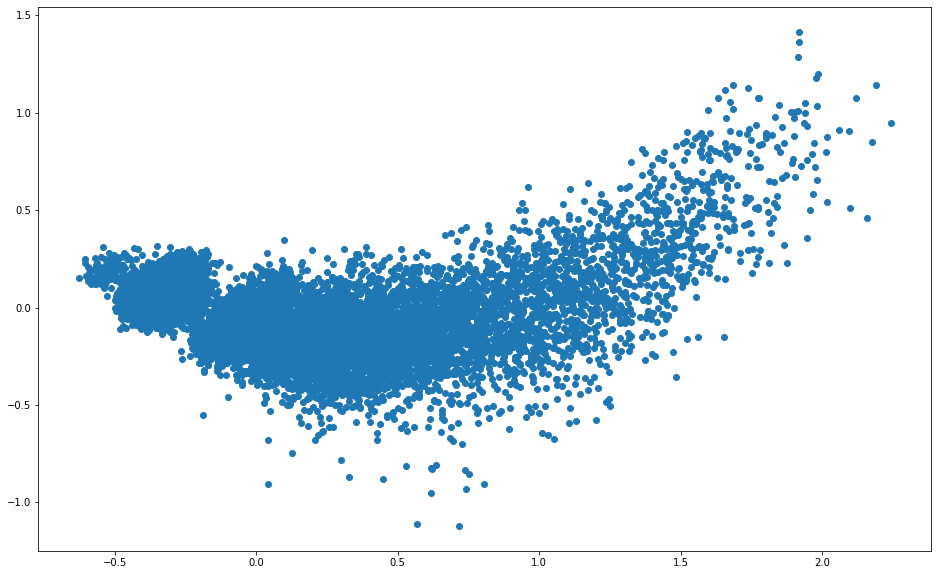

In [114]:
X = model[model.wv.vocab]

from sklearn.decomposition import PCA
pca = PCA(n_components=2)
result = pca.fit_transform(X)

plt.figure(figsize=(16, 10))
plt.scatter(result[:, 0], result[:, 1])

# words = list(model.wv.vocab)
# for i, word in enumerate(words):
#     plt.annotate(word, xy=(result[i, 0], result[i, 1]))
